## Telecom Chrun Case Study

#### Problem Statement :

In the telecom industry, customers are able to choose from multiple service providers and actively switch from one operator to another. In this highly competitive market, the telecommunications industry experiences an average of 15-25% annual churn rate. Given the fact that it costs 5-10 times more to acquire a new customer than to retain an existing one, customer retention has now become even more important than customer acquisition. 

For many incumbent operators, retaining high profitable customers is the number one business goal.

A leading telecom firm wants :

- to predict which customers are at high risk of churn to reduce customer churn.

#### Objective :

- Build the model to predict the churn in the last (i.e. the ninth) month using the data (features) from the first three months.
- Build model to identify the main indicators of churn.


### Importing and Understanding Data

In [242]:
# Suppressing Warnings
import warnings
warnings.filterwarnings('ignore')

In [243]:
# Importing all required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import gc
gc.collect()

# To display all the columns and rows
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

In [244]:
# Importing dataset
churn_data = pd.read_csv("telecom_churn_data.csv")
# Check head of the dataset
churn_data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,0.00,0.00,0.00,0.00,NaN,NaN,0.16,NaN,NaN,NaN,4.13,NaN,NaN,NaN,1.15,NaN,NaN,NaN,5.44,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,5.44,0.00,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,4,3,

In [245]:
#Inspect the various aspects of the Telecom Churn dataframe

start = "\033[1m"
end = "\033[0;0m"
print("\n"+start+"Datatype of each Column"+end+"\n")
print(churn_data.info())# Datatype of each Column
print("\n"+start+"Summary of operations on numeric columns in dataframe"+end+"\n")
print(churn_data.describe()) # Summary of operations on numeric columns in dataframe
print("\n"+start+"Name of the type of collection"+end+"\n")
print(type(churn_data)) # Returns the name of the type of collection
print("\n"+start+"Number rows and columns"+end+"\n")
print(churn_data.shape) # Returns number of rows and columns 
print("\n"+start+"Columns present in Dataframe"+end+"\n")
print(churn_data.columns) # Returns the Columns present in Dataframe
print("\n"+start+"Numpy array of nested list of values"+end+"\n")
print(churn_data.values) # Returns the numpy array of nested list of values


Datatype of each Column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB
None

Summary of operations on numeric columns in dataframe

       mobile_number  circle_id  loc_og_t2o_mou  std_og_t2o_mou  \
count   9.999900e+04    99999.0         98981.0         98981.0   
mean    7.001207e+09      109.0             0.0             0.0   
std     6.956694e+05        0.0             0.0             0.0   
min     7.000000e+09      109.0             0.0             0.0   
25%     7.000606e+09      109.0             0.0             0.0   
50%     7.001205e+09      109.0             0.0             0.0   
75%     7.001812e+09      109.0             0.0             0.0   
max     7.002411e+09      109.0             0.0             0.0   

       loc_ic_t2o_mou        arpu_6        arpu_7        arpu_8        arpu_9  \
count         98981.0  99999.00000

[[7000842753 109 0.0 ... 0.0 101.2 3.58]
 [7001865778 109 0.0 ... 0.0 0.0 0.0]
 [7001625959 109 0.0 ... 0.0 4.17 0.0]
 ...
 [7000087541 109 0.0 ... 0.0 0.0 0.0]
 [7000498689 109 0.0 ... 1151.03 1173.18 0.0]
 [7001905007 109 0.0 ... 0.0 0.0 0.0]]


### Data Cleaning

#### Drop unnecessary columns

In dataframe, the columns `circle_id`,`loc_og_t2o_mou`,`std_og_t2o_mou`,`loc_ic_t2o_mou`,`std_og_t2c_mou_6`,`std_og_t2c_mou_7`,`std_og_t2c_mou_8`,`std_og_t2c_mou_9`are having only single value which will not help in making predictions. So, we can drop these columns.

In [246]:
col = ['circle_id','loc_og_t2o_mou','std_og_t2o_mou','loc_ic_t2o_mou','std_og_t2c_mou_6','std_og_t2c_mou_7','std_og_t2c_mou_8','std_og_t2c_mou_9']

churn_data.drop(col,axis=1,inplace=True)

#### Dealing with Missing Values

In [247]:
# Finding the % of Missing values in each column

round((100*(churn_data.isnull().sum())/len(churn_data.index)),2)

mobile_number                0.00
last_date_of_month_6         0.00
last_date_of_month_7         0.60
last_date_of_month_8         1.10
last_date_of_month_9         1.66
arpu_6                       0.00
arpu_7                       0.00
arpu_8                       0.00
arpu_9                       0.00
onnet_mou_6                  3.94
onnet_mou_7                  3.86
onnet_mou_8                  5.38
onnet_mou_9                  7.75
offnet_mou_6                 3.94
offnet_mou_7                 3.86
offnet_mou_8                 5.38
offnet_mou_9                 7.75
roam_ic_mou_6                3.94
roam_ic_mou_7                3.86
roam_ic_mou_8                5.38
roam_ic_mou_9                7.75
roam_og_mou_6                3.94
roam_og_mou_7                3.86
roam_og_mou_8                5.38
roam_og_mou_9                7.75
loc_og_t2t_mou_6             3.94
loc_og_t2t_mou_7             3.86
loc_og_t2t_mou_8             5.38
loc_og_t2t_mou_9             7.75
loc_og_t2m_mou

From the above null percentage data for each column, we can see that many of the columns showing high null percentage can be just because the user has not opted for that service in that month and hence the value is missing.

The columns with that kind of data are :

`total_rech_data_6`,`total_rech_data_7`,`total_rech_data_8`,`total_rech_data_9`,`max_rech_data_6`,`max_rech_data_7`,`max_rech_data_8`,<br>
`max_rech_data_9`,`count_rech_2g_6`,`count_rech_2g_7`,`count_rech_2g_8`,`count_rech_2g_9`,`count_rech_3g_6`,`count_rech_3g_7`,`count_rech_3g_8`,<br>
`count_rech_3g_9`,`av_rech_amt_data_6`,`av_rech_amt_data_7`,`av_rech_amt_data_8`,`av_rech_amt_data_9`,`arpu_3g_6`,`arpu_3g_7`,`arpu_3g_8`,<br>`arpu_3g_9`,`arpu_2g_6`,`arpu_2g_7`,`arpu_2g_8`,`arpu_2g_9`,`night_pck_user_6`,`night_pck_user_7`,`night_pck_user_8`,`night_pck_user_9`,<br>`fb_user_6`,`fb_user_7`,`fb_user_8`,`fb_user_9`

For the above columns we can impute the null values with zero. For example, if we see for column totaol_rech_data_6 - in this column the null % indicates that the person has not recharged for the data at all and hence it can be imputed with zero. The same goes for all other columns mentioned above.

In [248]:
# Columns for imputation with zero for null

columns = ['total_rech_data_6','total_rech_data_7','total_rech_data_8','total_rech_data_9','max_rech_data_6','max_rech_data_7','max_rech_data_8','max_rech_data_9','count_rech_2g_6','count_rech_2g_7','count_rech_2g_8','count_rech_2g_9','count_rech_3g_6','count_rech_3g_7','count_rech_3g_8','count_rech_3g_9','av_rech_amt_data_6','av_rech_amt_data_7','av_rech_amt_data_8','av_rech_amt_data_9','arpu_3g_6','arpu_3g_7','arpu_3g_8','arpu_3g_9','arpu_2g_6','arpu_2g_7','arpu_2g_8','arpu_2g_9','night_pck_user_6','night_pck_user_7','night_pck_user_8','night_pck_user_9','fb_user_6','fb_user_7','fb_user_8','fb_user_9']

churn_data[columns] = churn_data[columns].fillna(0)

Now that we have imputed all meaningful missing with value zero, we can drop the columns where the missing is more than 30%.
There are columns which are having 70+ % as misisng values

In [249]:
# Columns with high missing percentage.

col_drop=['date_of_last_rech_data_6','date_of_last_rech_data_7','date_of_last_rech_data_8','date_of_last_rech_data_9']

churn_data.drop(col_drop,axis=1,inplace=True)

In [250]:
# Finding the % of Missing values in each column

round((100*(churn_data.isnull().sum())/len(churn_data.index)),2)

mobile_number           0.00
last_date_of_month_6    0.00
last_date_of_month_7    0.60
last_date_of_month_8    1.10
last_date_of_month_9    1.66
arpu_6                  0.00
arpu_7                  0.00
arpu_8                  0.00
arpu_9                  0.00
onnet_mou_6             3.94
onnet_mou_7             3.86
onnet_mou_8             5.38
onnet_mou_9             7.75
offnet_mou_6            3.94
offnet_mou_7            3.86
offnet_mou_8            5.38
offnet_mou_9            7.75
roam_ic_mou_6           3.94
roam_ic_mou_7           3.86
roam_ic_mou_8           5.38
roam_ic_mou_9           7.75
roam_og_mou_6           3.94
roam_og_mou_7           3.86
roam_og_mou_8           5.38
roam_og_mou_9           7.75
loc_og_t2t_mou_6        3.94
loc_og_t2t_mou_7        3.86
loc_og_t2t_mou_8        5.38
loc_og_t2t_mou_9        7.75
loc_og_t2m_mou_6        3.94
loc_og_t2m_mou_7        3.86
loc_og_t2m_mou_8        5.38
loc_og_t2m_mou_9        7.75
loc_og_t2f_mou_6        3.94
loc_og_t2f_mou

From above list, we can see that none of the columns are having high missing percentage and doesn't have any meaningful missing.
Now, we can drop all the date columns as the data related to each month is already existing and particular date is not useful for our study.
The date columns are : 
`last_date_of_month_6`
`last_date_of_month_7`
`last_date_of_month_8`
`last_date_of_month_9`
`date_of_last_rech_6`
`date_of_last_rech_7`
`date_of_last_rech_8`
`date_of_last_rech_9`

In [251]:
date_col = ['last_date_of_month_6','last_date_of_month_7','last_date_of_month_8','last_date_of_month_9','date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8','date_of_last_rech_9']

churn_data.drop(date_col,axis=1,inplace=True)

Before we can proceed with data imputation for missing values, we can dummyfy our categorical columns.
Here we are excluding the 9th month data.
The categorical columns present in our dataframe are : 

`monthly_2g_6`,`monthly_2g_7`,`monthly_2g_8`,`sachet_2g_6`,`sachet_2g_7`,`sachet_2g_8`,`monthly_3g_6`,<br>`monthly_3g_7`,`monthly_3g_8`,`sachet_3g_6`,`sachet_3g_7`,`sachet_3g_8`

In [252]:
columns = ['monthly_2g_6','monthly_2g_7','monthly_2g_8','sachet_2g_6','sachet_2g_7','sachet_2g_8','monthly_3g_6','monthly_3g_7','monthly_3g_8','sachet_3g_6','sachet_3g_7','sachet_3g_8']

churn_data[columns] = churn_data[columns].astype('object')

In [253]:
# Creating a dummy variable for some of the categorical variables and dropping the first one.
dummy1 = pd.get_dummies(churn_data[['monthly_2g_6','monthly_2g_7','monthly_2g_8','sachet_2g_6','sachet_2g_7','sachet_2g_8','monthly_3g_6','monthly_3g_7','monthly_3g_8','sachet_3g_6','sachet_3g_7','sachet_3g_8']],drop_first=True)

# Adding the results to the master dataframe
churn_data = pd.concat([churn_data, dummy1], axis=1)

churn_data.head()

,mobile_number,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_30,sachet_2g_6_32,sachet_2g_6_34,sachet_2g_6_39,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,

In [254]:
# Delete this before sunbmitting
churn_data.monthly_2g_6_1.value_counts()

0    93271
1     6728
Name: monthly_2g_6_1, dtype: int64

In [255]:
# We have created dummies for the below variables, so we can drop them
churn_data = churn_data.drop(['monthly_2g_6','monthly_2g_7','monthly_2g_8','sachet_2g_6','sachet_2g_7','sachet_2g_8','monthly_3g_6','monthly_3g_7','monthly_3g_8','sachet_3g_6','sachet_3g_7','sachet_3g_8'],axis=1)

### `Filtering High Value Customers`
From the data given to us, we need to filter out the high value customer as the focus is on the top 20% customers who actually bring 80% of the revenue.

So, we will filter out 30% of the high value customers for better approach.

As it has already been explained by the telecom firm that the 6 and 7 month i.e. June and July are the Good phase and hence it is the appropriate time to filter out High Value Customers.

We will be doing our further filtering based on these months only.

###### Calculate Total Recharge Amount 

We need to find the total amount spent on recharge including Data by customers in the month of June and July

In [256]:
# Calculate Total Data Recharge Amount for month 6 from average amount given
churn_data['Total_Data_Recharge_Amt_6'] = churn_data.total_rech_data_6 * churn_data.av_rech_amt_data_6

# Calculate Total Data Recharge Amount for month 6 from average amount given
churn_data['Total_Data_Recharge_Amt_7'] = churn_data.total_rech_data_7 * churn_data.av_rech_amt_data_7

# Calculate Total Recharge Amount for month 6 from the total recharge data given in dataframe and total data recharge calculated above
churn_data['Total_Recharge_Amt_6'] = churn_data.total_rech_amt_6 + churn_data.Total_Data_Recharge_Amt_6

# Calculate Total Recharge Amount for months 7 from the total recharge data given in dataframe and total data recharge calculated above
churn_data['Total_Recharge_Amt_7'] = churn_data.total_rech_amt_7 + churn_data.Total_Data_Recharge_Amt_7

###### Calculate Average Recharge Amount in the month 6 and 7 combined

Calculate the Average amount spent on recharge by customer in the month 6 and 7

In [257]:
# Calculate the Average amount in the month 6 and 7 using the above derived columns
churn_data['Average_Recharge_Amt_6_7'] = (churn_data.Total_Recharge_Amt_6 + churn_data.Total_Recharge_Amt_7)/2

In [258]:
# Find the 70th percentile of the Average_Recharge_Amt_6_7 column

percentile_70 = churn_data.Average_Recharge_Amt_6_7.quantile(0.7) # 70th percentile

In [259]:
# Filter out the data based on the 70th percentile value
churn_data = churn_data[churn_data.Average_Recharge_Amt_6_7>=percentile_70]

In [260]:
# Shape of the Churn_data after filtering High Value Customers
churn_data.shape

(30001, 425)

Now, we have successfully filtered out the high value customers, we will now try and impute the missing value using Advance imputation methods.

We will go with KNN to impute the missing values as it take care of everything and will not take high time to converge.

In [261]:
#importing fancyimpute 
from fancyimpute import KNN

Excluding `mobile_number` column while applying the KNN imputation algorithm as `mobile_number` doesn't contribute to decide the missing value.

In [262]:
#creating churn_data_1 excluding mobile_number column  
churn_data_1 = churn_data.drop("mobile_number", axis  = 1)


In [263]:
import gc

gc.collect()

200

##### Applying KNN imputation

In [264]:
churn_data_knn = pd.DataFrame(KNN(k=5).fit_transform(churn_data_1))
churn_data_knn.columns = churn_data_1.columns
churn_data_knn.head()

Imputing row 1/30001 with 84 missing, elapsed time: 3166.431
Imputing row 101/30001 with 0 missing, elapsed time: 3166.891
Imputing row 201/30001 with 56 missing, elapsed time: 3167.115
Imputing row 301/30001 with 0 missing, elapsed time: 3167.224
Imputing row 401/30001 with 0 missing, elapsed time: 3167.256
Imputing row 501/30001 with 0 missing, elapsed time: 3167.398
Imputing row 601/30001 with 0 missing, elapsed time: 3167.487
Imputing row 701/30001 with 0 missing, elapsed time: 3167.584
Imputing row 801/30001 with 0 missing, elapsed time: 3167.694
Imputing row 901/30001 with 0 missing, elapsed time: 3167.770
Imputing row 1001/30001 with 0 missing, elapsed time: 3167.861
Imputing row 1101/30001 with 0 missing, elapsed time: 3168.063
Imputing row 1201/30001 with 0 missing, elapsed time: 3168.256
Imputing row 1301/30001 with 0 missing, elapsed time: 3168.304
Imputing row 1401/30001 with 0 missing, elapsed time: 3168.364
Imputing row 1501/30001 with 0 missing, elapsed time: 3168.511
Im

Imputing row 13001/30001 with 0 missing, elapsed time: 3181.217
Imputing row 13101/30001 with 0 missing, elapsed time: 3181.332
Imputing row 13201/30001 with 0 missing, elapsed time: 3181.486
Imputing row 13301/30001 with 0 missing, elapsed time: 3181.702
Imputing row 13401/30001 with 0 missing, elapsed time: 3181.920
Imputing row 13501/30001 with 0 missing, elapsed time: 3182.011
Imputing row 13601/30001 with 0 missing, elapsed time: 3182.100
Imputing row 13701/30001 with 0 missing, elapsed time: 3182.211
Imputing row 13801/30001 with 0 missing, elapsed time: 3182.321
Imputing row 13901/30001 with 0 missing, elapsed time: 3182.431
Imputing row 14001/30001 with 0 missing, elapsed time: 3182.516
Imputing row 14101/30001 with 0 missing, elapsed time: 3182.644
Imputing row 14201/30001 with 0 missing, elapsed time: 3182.714
Imputing row 14301/30001 with 0 missing, elapsed time: 3182.815
Imputing row 14401/30001 with 0 missing, elapsed time: 3182.942
Imputing row 14501/30001 with 0 missing,

Imputing row 25801/30001 with 28 missing, elapsed time: 3195.857
Imputing row 25901/30001 with 0 missing, elapsed time: 3196.028
Imputing row 26001/30001 with 0 missing, elapsed time: 3196.156
Imputing row 26101/30001 with 0 missing, elapsed time: 3196.250
Imputing row 26201/30001 with 0 missing, elapsed time: 3196.351
Imputing row 26301/30001 with 0 missing, elapsed time: 3196.493
Imputing row 26401/30001 with 0 missing, elapsed time: 3196.650
Imputing row 26501/30001 with 0 missing, elapsed time: 3196.860
Imputing row 26601/30001 with 0 missing, elapsed time: 3196.979
Imputing row 26701/30001 with 0 missing, elapsed time: 3197.098
Imputing row 26801/30001 with 0 missing, elapsed time: 3197.294
Imputing row 26901/30001 with 0 missing, elapsed time: 3197.478
Imputing row 27001/30001 with 0 missing, elapsed time: 3197.649
Imputing row 27101/30001 with 0 missing, elapsed time: 3197.808
Imputing row 27201/30001 with 0 missing, elapsed time: 3197.848
Imputing row 27301/30001 with 0 missing

,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_9,sachet_2g_9,monthly_3g_9,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_30,sachet_2g_6_32,sachet_2g_6_34,sachet_2g_6_39,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,sachet_2g_7_25,sachet_2g_7_26,sachet_2g_7_27,sachet_2g_7_28,sachet_2g_7_29,sachet_2g_7_30,sachet_2g_7_32,sachet_2g_7_35,sachet_2g_7_42,sachet_2g_7_48,sachet_2g_8_1,

In [659]:
churn_data_knn1 = churn_data_knn.copy()

##### Check the missing percentage after the missing value imputation

In [660]:
# Finding the % of Missing values in each column

round((100*(churn_data_knn.isnull().sum())/len(churn_data_knn.index)),2)

arpu_6                       0.0
arpu_7                       0.0
arpu_8                       0.0
arpu_9                       0.0
onnet_mou_6                  0.0
onnet_mou_7                  0.0
onnet_mou_8                  0.0
onnet_mou_9                  0.0
offnet_mou_6                 0.0
offnet_mou_7                 0.0
offnet_mou_8                 0.0
offnet_mou_9                 0.0
roam_ic_mou_6                0.0
roam_ic_mou_7                0.0
roam_ic_mou_8                0.0
roam_ic_mou_9                0.0
roam_og_mou_6                0.0
roam_og_mou_7                0.0
roam_og_mou_8                0.0
roam_og_mou_9                0.0
loc_og_t2t_mou_6             0.0
loc_og_t2t_mou_7             0.0
loc_og_t2t_mou_8             0.0
loc_og_t2t_mou_9             0.0
loc_og_t2m_mou_6             0.0
loc_og_t2m_mou_7             0.0
loc_og_t2m_mou_8             0.0
loc_og_t2m_mou_9             0.0
loc_og_t2f_mou_6             0.0
loc_og_t2f_mou_7             0.0
loc_og_t2f

### Deriving the Dependent Variable i.e. Churn Data

We will derive our churn data based on the data present for 9th month.

We will do usage based churn i.e. based on incoming and outgoing calls and data used

In [661]:
# We will calculate total incoming calls in 9th month

churn_data_knn['Total_Incoming_Calls_9'] = churn_data_knn.roam_ic_mou_9 + churn_data_knn.total_ic_mou_9

# We will calculate total outgoing calls in 9th month

churn_data_knn['Total_Outgoing_Calls_9'] = churn_data_knn.roam_og_mou_9 + churn_data_knn.total_og_mou_9

In [662]:
# Fucntion to check condition to assign whether the customer has churned
def conditions(x):
    if (x['Total_Incoming_Calls_9'] == 0) and (x['Total_Outgoing_Calls_9'] == 0) and (x['vol_2g_mb_9'] == 0) and (x['vol_3g_mb_9'] == 0):
        return 1
    else:
        return 0

In [663]:
# Creating the new column Churned which has the value if the customer has churned. 1 indicates that the customer has churned and 0 indicates not churned

churn_data_knn['Churned'] = churn_data_knn.apply(conditions, axis=1)

In [664]:
# Calculate the churn percentage

(churn_data_knn.Churned.value_counts()/len(churn_data_knn))*100

0    98.193394
1     1.806606
Name: Churned, dtype: float64

From above, we see that around 1.8% customers have churned in 9th month. 
Now that we have derived the churned column(dependent variable), we can now proceed with dropping all columns related to 9th month

In [665]:
# 9th month columns
col_9 = ['arpu_9','onnet_mou_9','offnet_mou_9','roam_ic_mou_9','roam_og_mou_9','loc_og_t2t_mou_9','loc_og_t2m_mou_9','loc_og_t2f_mou_9','loc_og_t2c_mou_9','loc_og_mou_9','std_og_t2t_mou_9','std_og_t2m_mou_9','std_og_t2f_mou_9','std_og_mou_9','isd_og_mou_9','spl_og_mou_9','og_others_9','total_og_mou_9','loc_ic_t2t_mou_9','loc_ic_t2m_mou_9','loc_ic_t2f_mou_9','loc_ic_mou_9','std_ic_t2t_mou_9','std_ic_t2m_mou_9','std_ic_t2f_mou_9','std_ic_t2o_mou_9','std_ic_mou_9','total_ic_mou_9','spl_ic_mou_9','isd_ic_mou_9','ic_others_9','total_rech_num_9','total_rech_amt_9','max_rech_amt_9','last_day_rch_amt_9','total_rech_data_9','max_rech_data_9','count_rech_2g_9','count_rech_3g_9','av_rech_amt_data_9','vol_2g_mb_9','vol_3g_mb_9','arpu_3g_9','arpu_2g_9','night_pck_user_9','monthly_2g_9','sachet_2g_9','monthly_3g_9','sachet_3g_9','fb_user_9','Total_Incoming_Calls_9','Total_Outgoing_Calls_9']
churn_data_knn.drop(col_9,axis=1,inplace=True)

In [666]:
churn_data_knn.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_30,sachet_2g_6_32,sachet_2g_6_34,sachet_2g_6_39,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,sachet_2g_7_25,sachet_2g_7_26,sachet_2g_7_27,sachet_2g_7_28,sachet_2g_7_29,sachet_2g_7_30,sachet_2g_7_32,sachet_2g_7_35,sachet_2g_7_42,sachet_2g_7_48,sachet_2g_8_1,sachet_2g_8_2,sachet_2g_8_3,sachet_2g_8_4,sachet_2g_8_5,sachet_2g_8_6,sachet_2g_8_7,sachet_2g_8_8,sachet_2g_8_9,sachet_2g_8_10,sachet_2g_8_11,sachet_2g_8_12,sachet_2g_8_13,sachet_2g_8_14,sachet_2g_8_15,sachet_2g_8_16,sachet_2g_8_17,sachet_2g_8_18,sachet_2g_8_19,sachet_2g_8_20,sachet_2g_8_21,sachet_2g_8_22,sachet_2g_8_23,sachet_2g_8_24,sachet_2g_8_25,sachet_2g_8_26,sachet_2g_8_27,sachet_2g_8_29,sachet_2g_8_31,sachet_2g_8_32,sachet_2g_8_33,sachet_2g_8_34,sachet_2g_8_44,monthly_3g_6_1,monthly_3g_6_2,monthly_3g_6_3,monthly_3g_6_4,monthly_3g_6_5,monthly_3g_6_6,monthly_3g_6_7,monthly_3g_6_8,monthly_3g_6_9,monthly_3g_6_11,monthly_3g_6_14,monthly_3g_7_1,monthly_3g_7_2,monthly_3g_7_3,monthly_3g_7_4,monthly_3g_7_5,monthly_3g_7_6,m

#### Creating derived columns for 8th month

Creating `Total_Recharge_Amt_8` column which is derived from total recharge amount including data recharge amount.

In [667]:
# Calculate Total Data Recharge Amount for month 8 from average amount given
churn_data['Total_Data_Recharge_Amt_8'] = churn_data.total_rech_data_8 * churn_data.av_rech_amt_data_8

# Calculate Total Recharge Amount for month 8 from the total recharge data given in dataframe and total data recharge calculated above
churn_data['Total_Recharge_Amt_8'] = churn_data.total_rech_amt_8 + churn_data.Total_Data_Recharge_Amt_8


In [668]:
#Adding the derived columns to the churn_data_knn dataframe.
churn_data_knn.insert(loc=(len(churn_data_knn.columns)-1),column='Total_Data_Recharge_Amt_8',value=churn_data['Total_Data_Recharge_Amt_8'].values)
churn_data_knn.insert(loc=(len(churn_data_knn.columns)-1),column='Total_Recharge_Amt_8',value=churn_data['Total_Recharge_Amt_8'].values)
churn_data_knn.head()


,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_30,sachet_2g_6_32,sachet_2g_6_34,sachet_2g_6_39,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,sachet_2g_7_25,sachet_2g_7_26,sachet_2g_7_27,sachet_2g_7_28,sachet_2g_7_29,sachet_2g_7_30,sachet_2g_7_32,sachet_2g_7_35,sachet_2g_7_42,sachet_2g_7_48,sachet_2g_8_1,sachet_2g_8_2,sachet_2g_8_3,sachet_2g_8_4,sachet_2g_8_5,sachet_2g_8_6,sachet_2g_8_7,sachet_2g_8_8,sachet_2g_8_9,sachet_2g_8_10,sachet_2g_8_11,sachet_2g_8_12,sachet_2g_8_13,sachet_2g_8_14,sachet_2g_8_15,sachet_2g_8_16,sachet_2g_8_17,sachet_2g_8_18,sachet_2g_8_19,sachet_2g_8_20,sachet_2g_8_21,sachet_2g_8_22,sachet_2g_8_23,sachet_2g_8_24,sachet_2g_8_25,sachet_2g_8_26,sachet_2g_8_27,sachet_2g_8_29,sachet_2g_8_31,sachet_2g_8_32,sachet_2g_8_33,sachet_2g_8_34,sachet_2g_8_44,monthly_3g_6_1,monthly_3g_6_2,monthly_3g_6_3,monthly_3g_6_4,monthly_3g_6_5,monthly_3g_6_6,monthly_3g_6_7,monthly_3g_6_8,monthly_3g_6_9,monthly_3g_6_11,monthly_3g_6_14,monthly_3g_7_1,monthly_3g_7_2,monthly_3g_7_3,monthly_3g_7_4,monthly_3g_7_5,monthly_3g_7_6,m

We will also create derived columns for total incoming and outgoing calls for 6th,7th and 8th months.

In [669]:
# We will calculate total incoming calls in 6th month

churn_data_knn['Total_Incoming_Calls_6'] = churn_data_knn.roam_ic_mou_6 + churn_data_knn.total_ic_mou_6

# We will calculate total outgoing calls in 6th month

churn_data_knn['Total_Outgoing_Calls_6'] = churn_data_knn.roam_og_mou_6 + churn_data_knn.total_og_mou_6

In [670]:
# We will calculate total incoming calls in 7th month

churn_data_knn['Total_Incoming_Calls_7'] = churn_data_knn.roam_ic_mou_7 + churn_data_knn.total_ic_mou_7

# We will calculate total outgoing calls in 7th month

churn_data_knn['Total_Outgoing_Calls_7'] = churn_data_knn.roam_og_mou_7 + churn_data_knn.total_og_mou_7

In [671]:
# We will calculate total incoming calls in 8th month

churn_data_knn['Total_Incoming_Calls_8'] = churn_data_knn.roam_ic_mou_8 + churn_data_knn.total_ic_mou_8

# We will calculate total outgoing calls in 8th month

churn_data_knn['Total_Outgoing_Calls_8'] = churn_data_knn.roam_og_mou_8 + churn_data_knn.total_og_mou_8

### Data Visualisation

##### Numerical univariate analysis

##### `Density Plot`

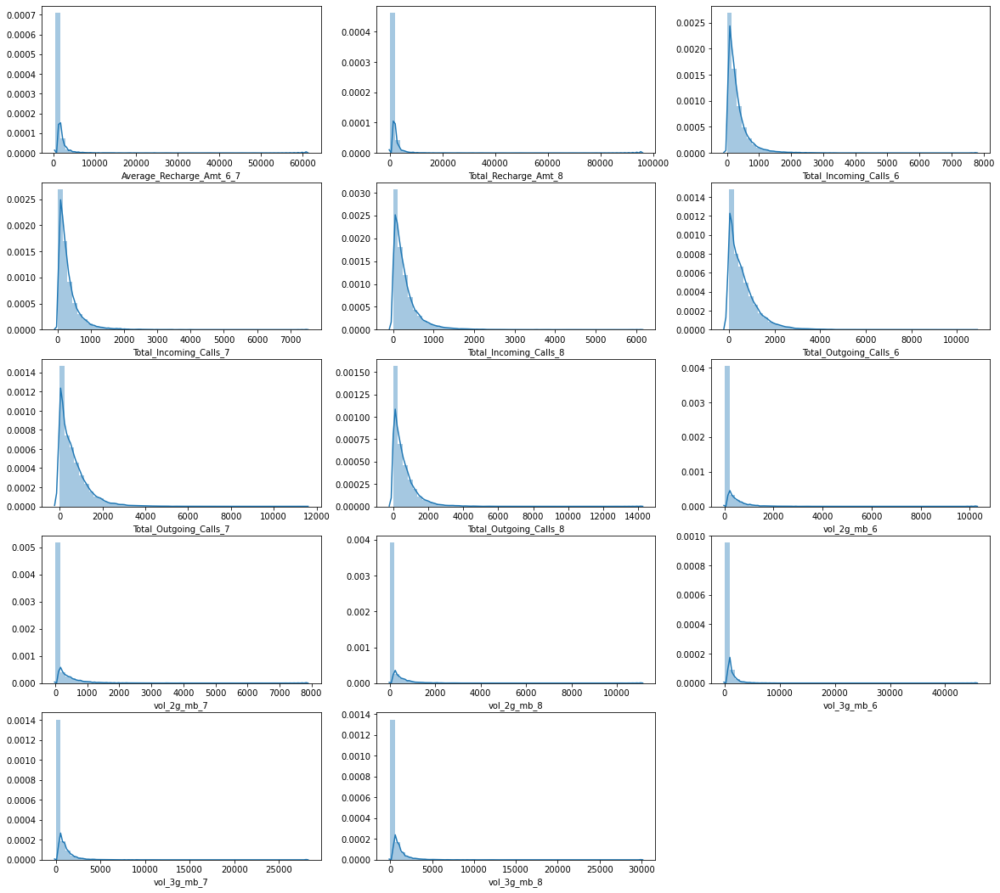

In [278]:
# PLot individual graphs for each numerical column.(taking columns which seem to be important)
features=['Average_Recharge_Amt_6_7', 'Total_Recharge_Amt_8', 'Total_Incoming_Calls_6', 'Total_Incoming_Calls_7','Total_Incoming_Calls_8',
          'Total_Outgoing_Calls_6','Total_Outgoing_Calls_7','Total_Outgoing_Calls_8','vol_2g_mb_6', 'vol_2g_mb_7', 'vol_2g_mb_8',
         'vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8']
plt.figure(figsize=(20,30))
for i in enumerate (features):
    plt.subplot(8,3,i[0]+1)
    sns.distplot(churn_data_knn[i[1]])

After looking at the density plots of some of the columns, we can conclude that there are a huge range of outliers on the right end of the data i.e. the plots have right tails.<br>
We Will plot box plots further to get clear picture.

##### `Box Plot`

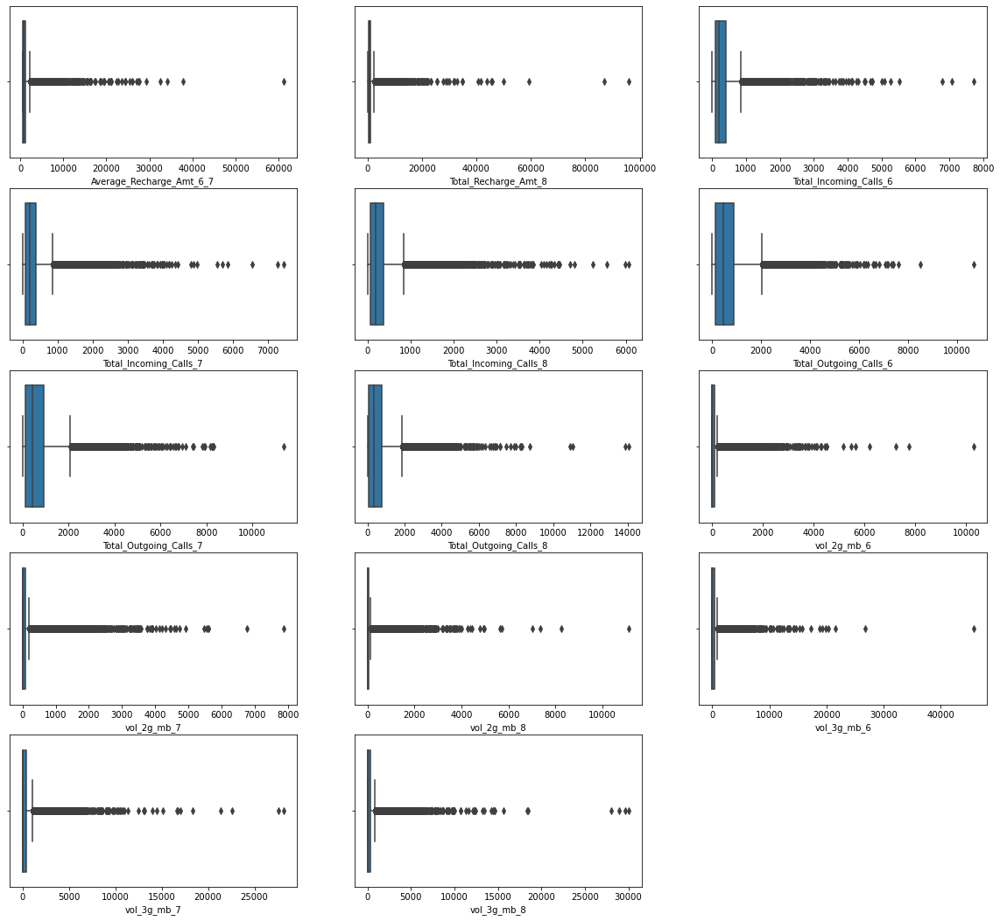

In [279]:
# Plotting box plots to see if there are any outliers

plt.figure(figsize = (20,30))
features = ['Average_Recharge_Amt_6_7', 'Total_Recharge_Amt_8', 'Total_Incoming_Calls_6', 'Total_Incoming_Calls_7','Total_Incoming_Calls_8',
          'Total_Outgoing_Calls_6','Total_Outgoing_Calls_7','Total_Outgoing_Calls_8','vol_2g_mb_6', 'vol_2g_mb_7', 'vol_2g_mb_8',
         'vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8']
for i in enumerate(features):
    plt.subplot(8,3,i[0]+1)
    sns.boxplot(churn_data_knn[i[1]])

From above plots we can see that there are outliers in almost all the columns. So we can treat them by capping them with appropriate value.

In [672]:
#Capping

# For Average_Recharge_Amt_6_7
q4=churn_data_knn['Average_Recharge_Amt_6_7'].quantile(0.95)
churn_data_knn['Average_Recharge_Amt_6_7'][churn_data_knn['Average_Recharge_Amt_6_7']>=q4] = q4

# For Total_Recharge_Amt_8
q4=churn_data_knn['Total_Recharge_Amt_8'].quantile(0.95)
churn_data_knn['Total_Recharge_Amt_8'][churn_data_knn['Total_Recharge_Amt_8']>=q4] = q4

# For Total_Incoming_Calls_6
q4=churn_data_knn['Total_Incoming_Calls_6'].quantile(0.95)
churn_data_knn['Total_Incoming_Calls_6'][churn_data_knn['Total_Incoming_Calls_6']>=q4] = q4

# For Total_Incoming_Calls_7
q4=churn_data_knn['Total_Incoming_Calls_7'].quantile(0.95)
churn_data_knn['Total_Incoming_Calls_7'][churn_data_knn['Total_Incoming_Calls_7']>=q4] = q4

# For Total_Incoming_Calls_8
q4=churn_data_knn['Total_Incoming_Calls_8'].quantile(0.95)
churn_data_knn['Total_Incoming_Calls_8'][churn_data_knn['Total_Incoming_Calls_8']>=q4] = q4

# For Total_Outgoing_Calls_6
q4=churn_data_knn['Total_Outgoing_Calls_6'].quantile(0.95)
churn_data_knn['Total_Outgoing_Calls_6'][churn_data_knn['Total_Outgoing_Calls_6']>=q4] = q4

# For Total_Outgoing_Calls_7
q4=churn_data_knn['Total_Outgoing_Calls_7'].quantile(0.95)
churn_data_knn['Total_Outgoing_Calls_7'][churn_data_knn['Total_Outgoing_Calls_7']>=q4] = q4

#For Total_Outgoing_Calls_8
q1=churn_data_knn['Total_Outgoing_Calls_8'].quantile(0.95)
churn_data_knn['Total_Outgoing_Calls_8'][churn_data_knn['Total_Outgoing_Calls_8']>=q4] = q4

#For vol_2g_mb_6
q1=churn_data_knn['vol_2g_mb_6'].quantile(0.95)
churn_data_knn['vol_2g_mb_6'][churn_data_knn['vol_2g_mb_6']>=q4] = q4

#For Total_Outgoing_Calls_8
q1=churn_data_knn['vol_2g_mb_7'].quantile(0.95)
churn_data_knn['vol_2g_mb_7'][churn_data_knn['vol_2g_mb_7']>=q4] = q4

#For vol_2g_mb_8
q1=churn_data_knn['vol_2g_mb_8'].quantile(0.95)
churn_data_knn['vol_2g_mb_8'][churn_data_knn['vol_2g_mb_8']>=q4] = q4

#For vol_3g_mb_6
q1=churn_data_knn['vol_3g_mb_6'].quantile(0.95)
churn_data_knn['vol_3g_mb_6'][churn_data_knn['vol_3g_mb_6']>=q4] = q4

#For vol_3g_mb_7
q1=churn_data_knn['vol_3g_mb_7'].quantile(0.95)
churn_data_knn['vol_3g_mb_7'][churn_data_knn['vol_3g_mb_7']>=q4] = q4

#For vol_3g_mb_7
q1=churn_data_knn['vol_3g_mb_8'].quantile(0.95)
churn_data_knn['vol_3g_mb_8'][churn_data_knn['vol_3g_mb_8']>=q4] = q4



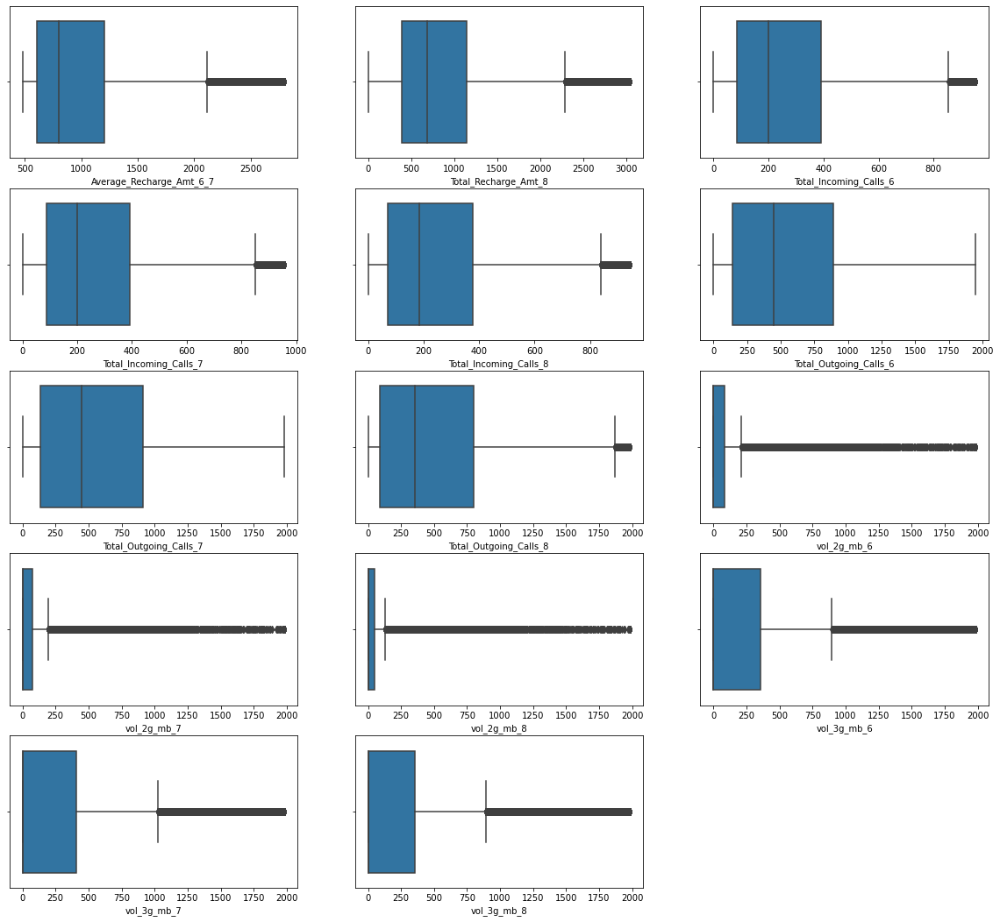

In [281]:
# Plotting box plots to see if there are any outliers

plt.figure(figsize = (20,30))
features = ['Average_Recharge_Amt_6_7', 'Total_Recharge_Amt_8', 'Total_Incoming_Calls_6', 'Total_Incoming_Calls_7','Total_Incoming_Calls_8',
          'Total_Outgoing_Calls_6','Total_Outgoing_Calls_7','Total_Outgoing_Calls_8','vol_2g_mb_6', 'vol_2g_mb_7', 'vol_2g_mb_8',
         'vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8']
for i in enumerate(features):
    plt.subplot(8,3,i[0]+1)
    sns.boxplot(churn_data_knn[i[1]])

We can see that many of the outliers are reduced to a great extent and their effect is reduced after capping.

###### Bivariate analysis on Numerical- Numerical variables.

We will visualise the multi collinearity within the columns and take necessary actions

###### `Correlation matrix`

In [282]:
# Checking correlation between the variables
corr = churn_data_knn.corr()
corr = corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))
corr_day = corr.unstack().reset_index()
corr_day.columns=['Variable1','Variable2','Correlation']
corr_day.dropna(subset=['Correlation'],inplace=True)
corr_day.Correlation = round(abs(corr_day['Correlation']),4)
corr_day.sort_values(by='Correlation', ascending=False)

,Variable1,Variable2,Correlation
95933,sachet_2g_8_31,sachet_2g_6_30,1.0000
140045,sachet_3g_8_29,sachet_2g_8_31,1.0000
84445,sachet_2g_7_42,sachet_2g_6_34,1.0000
139978,sachet_3g_8_29,sachet_2g_6_30,1.0000
139659,sachet_3g_8_27,sachet_2g_8_26,1.0000
96702,sachet_2g_8_33,sachet_2g_6_39,1.0000
111345,monthly_3g_8_16,monthly_3g_7_10,1.0000
37536,total_rech_amt_8,arpu_8,0.9554
36768,total_rech_amt_6,arpu_6,0.9461
16895,isd_og_mou_8,isd_og_mou_7,0.9439


As we can see from above table there are many columns which have high correlation. So we can drop such columns.

In [673]:
#Dropping highly correlated columns from churn_data_knn
drop_cols=['sachet_2g_8_31','sachet_2g_6_34','sachet_2g_8_26','monthly_3g_7_10','sachet_2g_6_30','sachet_2g_6_39','total_og_mou_7',
          'total_og_mou_8','total_og_mou_6','total_ic_mou_6','total_ic_mou_7','total_ic_mou_8','arpu_6','arpu_7','arpu_8',
          'Total_Data_Recharge_Amt_8','Total_Data_Recharge_Amt_7','Total_Data_Recharge_Amt_6','arpu_3g_6','arpu_3g_7','arpu_3g_8',
          'isd_og_mou_6','count_rech_2g_6','count_rech_2g_7','count_rech_2g_8','loc_ic_mou_6','loc_ic_mou_7','loc_ic_mou_8',
          'std_og_t2t_mou_8','std_og_t2t_mou_7','std_og_t2t_mou_6','std_og_t2m_mou_7','std_og_t2m_mou_8','arpu_2g_6','std_og_mou_8',
          'std_og_mou_7','Total_Recharge_Amt_6','Total_Recharge_Amt_7','arpu_2g_8','isd_og_mou_7']
churn_data_knn.drop(drop_cols,axis=1,inplace=True)

In [674]:
# Checking the shape of the churn_data_knn dataframe.
churn_data_knn.shape

(30001, 343)

We can now see how some the variables are changing w.r.t to target variable 
##### `Pair Plot`

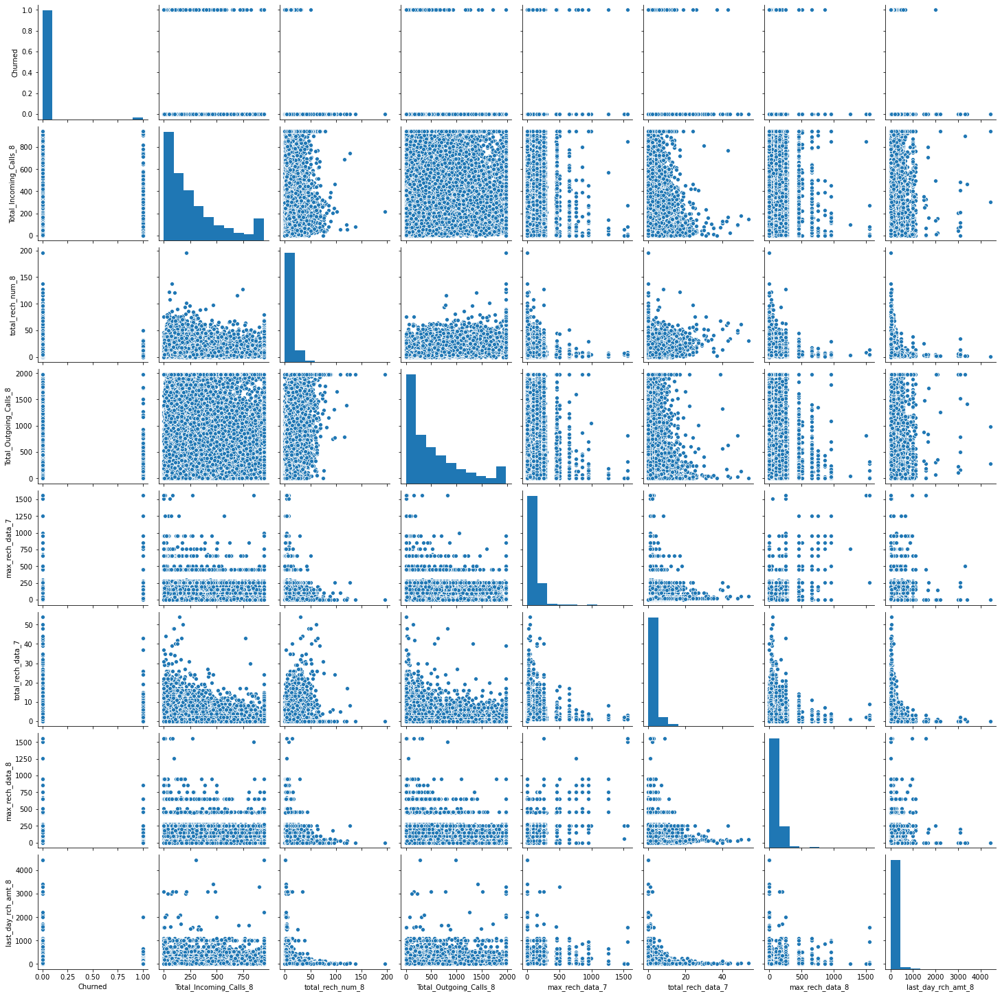

In [292]:
# Plotting pair plot between different variables and Target variable
cols=['Churned','Total_Incoming_Calls_8','total_rech_num_8','Total_Outgoing_Calls_8','max_rech_data_7','total_rech_data_7','max_rech_data_8','last_day_rch_amt_8']
sns.pairplot(churn_data_knn[cols])
plt.show()

### Checking if there is any imbalance in the data

In [675]:
# Calculate the churn percentage

(churn_data_knn.Churned.value_counts()/len(churn_data_knn))*100

0    98.193394
1     1.806606
Name: Churned, dtype: float64

As we can see, the target variable Churned is highly imbalanced. Here, almost 98% of the customers are not churned and almost 2% of the customers are churned. In this case we are required to handle the imbalance in the data.

### Handling imbalance in the data using SMOTE

In [677]:
# Load the function from the package
from imblearn.over_sampling import SMOTE

In [678]:
#Divide the data into X and y
y_data = churn_data_knn.pop('Churned')
#X_data = churn_data_knn
X_data = pd.DataFrame(churn_data_knn, columns=churn_data_knn.columns)

In [679]:
X_data.head()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2m_mou_6,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_2g_7,night_pck_user_6,night_pck_user_7,night_pck_user_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_32,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,sachet_2g_7_25,sachet_2g_7_26,sachet_2g_7_27,sachet_2g_7_28,sachet_2g_7_29,sachet_2g_7_30,sachet_2g_7_32,sachet_2g_7_35,sachet_2g_7_42,sachet_2g_7_48,sachet_2g_8_1,sachet_2g_8_2,sachet_2g_8_3,sachet_2g_8_4,sachet_2g_8_5,sachet_2g_8_6,sachet_2g_8_7,sachet_2g_8_8,sachet_2g_8_9,sachet_2g_8_10,sachet_2g_8_11,sachet_2g_8_12,sachet_2g_8_13,sachet_2g_8_14,sachet_2g_8_15,sachet_2g_8_16,sachet_2g_8_17,sachet_2g_8_18,sachet_2g_8_19,sachet_2g_8_20,sachet_2g_8_21,sachet_2g_8_22,sachet_2g_8_23,sachet_2g_8_24,sachet_2g_8_25,sachet_2g_8_27,sachet_2g_8_29,sachet_2g_8_32,sachet_2g_8_33,sachet_2g_8_34,sachet_2g_8_44,monthly_3g_6_1,monthly_3g_6_2,monthly_3g_6_3,monthly_3g_6_4,monthly_3g_6_5,monthly_3g_6_6,monthly_3g_6_7,monthly_3g_6_8,monthly_3g_6_9,monthly_3g_6_11,monthly_3g_6_14,monthly_3g_7_1,monthly_3g_7_2,monthly_3g_7_3,monthly_3g_7_4,monthly_3g_7_5,monthly_3g_7_6,monthly_3g_7_7,monthly_3g_7_8,monthly_3g_7_9,monthly_3g_7_11,monthly_3g_7_12,monthly_3g_7_14,monthly_3g_7_16,monthly_3g_8_1,monthly_3g_8_2,monthly_3g_8_3,monthly_3g_8_4,monthly_3g_8_5,monthly_3g_8_6,monthly_3g_8_7,monthly_3g_8_8,monthly_3g_8_9,monthly_3g_8_10,monthly_3g_8_16,sachet_3g_6_1,sachet_3g_6_2,sachet_3g_6_3,sachet_3g_6_4,sachet_3g_6_5,sachet_3g_6_6,sachet_3g_6_7,sachet_3g_6_8,sachet_3g_6_9,sachet_3g_6_10,sachet_3g_6_11,sachet_3g_6_12,sachet_3g_6_13

In [821]:
# SMOTE
smote = SMOTE(random_state=0)
X_smote, y_smote = smote.fit_resample(X_data, y_data)

In [822]:
X_smote=pd.DataFrame(X_smote,columns=X_data.columns)
X_smote.head()

,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2m_mou_6,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_2g_7,night_pck_user_6,night_pck_user_7,night_pck_user_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,monthly_2g_6_1,monthly_2g_6_2,monthly_2g_6_3,monthly_2g_6_4,monthly_2g_7_1,monthly_2g_7_2,monthly_2g_7_3,monthly_2g_7_4,monthly_2g_7_5,monthly_2g_8_1,monthly_2g_8_2,monthly_2g_8_3,monthly_2g_8_4,monthly_2g_8_5,sachet_2g_6_1,sachet_2g_6_2,sachet_2g_6_3,sachet_2g_6_4,sachet_2g_6_5,sachet_2g_6_6,sachet_2g_6_7,sachet_2g_6_8,sachet_2g_6_9,sachet_2g_6_10,sachet_2g_6_11,sachet_2g_6_12,sachet_2g_6_13,sachet_2g_6_14,sachet_2g_6_15,sachet_2g_6_16,sachet_2g_6_17,sachet_2g_6_18,sachet_2g_6_19,sachet_2g_6_20,sachet_2g_6_21,sachet_2g_6_22,sachet_2g_6_24,sachet_2g_6_25,sachet_2g_6_27,sachet_2g_6_28,sachet_2g_6_32,sachet_2g_6_42,sachet_2g_7_1,sachet_2g_7_2,sachet_2g_7_3,sachet_2g_7_4,sachet_2g_7_5,sachet_2g_7_6,sachet_2g_7_7,sachet_2g_7_8,sachet_2g_7_9,sachet_2g_7_10,sachet_2g_7_11,sachet_2g_7_12,sachet_2g_7_13,sachet_2g_7_14,sachet_2g_7_15,sachet_2g_7_16,sachet_2g_7_17,sachet_2g_7_18,sachet_2g_7_19,sachet_2g_7_20,sachet_2g_7_21,sachet_2g_7_22,sachet_2g_7_23,sachet_2g_7_24,sachet_2g_7_25,sachet_2g_7_26,sachet_2g_7_27,sachet_2g_7_28,sachet_2g_7_29,sachet_2g_7_30,sachet_2g_7_32,sachet_2g_7_35,sachet_2g_7_42,sachet_2g_7_48,sachet_2g_8_1,sachet_2g_8_2,sachet_2g_8_3,sachet_2g_8_4,sachet_2g_8_5,sachet_2g_8_6,sachet_2g_8_7,sachet_2g_8_8,sachet_2g_8_9,sachet_2g_8_10,sachet_2g_8_11,sachet_2g_8_12,sachet_2g_8_13,sachet_2g_8_14,sachet_2g_8_15,sachet_2g_8_16,sachet_2g_8_17,sachet_2g_8_18,sachet_2g_8_19,sachet_2g_8_20,sachet_2g_8_21,sachet_2g_8_22,sachet_2g_8_23,sachet_2g_8_24,sachet_2g_8_25,sachet_2g_8_27,sachet_2g_8_29,sachet_2g_8_32,sachet_2g_8_33,sachet_2g_8_34,sachet_2g_8_44,monthly_3g_6_1,monthly_3g_6_2,monthly_3g_6_3,monthly_3g_6_4,monthly_3g_6_5,monthly_3g_6_6,monthly_3g_6_7,monthly_3g_6_8,monthly_3g_6_9,monthly_3g_6_11,monthly_3g_6_14,monthly_3g_7_1,monthly_3g_7_2,monthly_3g_7_3,monthly_3g_7_4,monthly_3g_7_5,monthly_3g_7_6,monthly_3g_7_7,monthly_3g_7_8,monthly_3g_7_9,monthly_3g_7_11,monthly_3g_7_12,monthly_3g_7_14,monthly_3g_7_16,monthly_3g_8_1,monthly_3g_8_2,monthly_3g_8_3,monthly_3g_8_4,monthly_3g_8_5,monthly_3g_8_6,monthly_3g_8_7,monthly_3g_8_8,monthly_3g_8_9,monthly_3g_8_10,monthly_3g_8_16,sachet_3g_6_1,sachet_3g_6_2,sachet_3g_6_3,sachet_3g_6_4,sachet_3g_6_5,sachet_3g_6_6,sachet_3g_6_7,sachet_3g_6_8,sachet_3g_6_9,sachet_3g_6_10,sachet_3g_6_11,sachet_3g_6_12,sachet_3g_6_13

In [823]:
pd.Series(y_smote).value_counts(normalize = True)

1    0.5
0    0.5
Name: Churned, dtype: float64

In [824]:
pd.Series(y_smote).value_counts()

1    29459
0    29459
Name: Churned, dtype: int64

##### Convert the dummy columns to Int by taking round as the value is affected by SMOTE

In [825]:
cols = ['night_pck_user_6','night_pck_user_7','night_pck_user_8','fb_user_6','fb_user_7','fb_user_8','monthly_2g_6_1','monthly_2g_6_2','monthly_2g_6_4','monthly_2g_7_1','monthly_2g_7_2','monthly_2g_8_1','sachet_2g_6_1','sachet_2g_6_2','sachet_2g_6_3','sachet_2g_6_4','sachet_2g_6_5','sachet_2g_6_6','sachet_2g_6_7','sachet_2g_6_8','sachet_2g_6_9','sachet_2g_6_10','sachet_2g_6_11','sachet_2g_6_12','sachet_2g_6_13','sachet_2g_6_14','sachet_2g_6_15','sachet_2g_6_18','sachet_2g_6_22','sachet_2g_6_28','sachet_2g_7_1','sachet_2g_7_2','sachet_2g_7_3','sachet_2g_7_4','sachet_2g_7_5','sachet_2g_7_6','sachet_2g_7_7','sachet_2g_7_8','sachet_2g_7_9','sachet_2g_7_10','sachet_2g_7_11','sachet_2g_7_12','sachet_2g_7_13','sachet_2g_7_14','sachet_2g_7_15','sachet_2g_7_16','sachet_2g_7_17','sachet_2g_7_18','sachet_2g_7_19','sachet_2g_7_20','sachet_2g_7_21','sachet_2g_7_22','sachet_2g_7_23','sachet_2g_7_24','sachet_2g_7_25','sachet_2g_7_26','sachet_2g_7_27','sachet_2g_7_28','sachet_2g_7_29','sachet_2g_7_30','sachet_2g_7_32','sachet_2g_7_35','sachet_2g_7_42','sachet_2g_7_48','sachet_2g_8_1','sachet_2g_8_2','sachet_2g_8_3','sachet_2g_8_4','sachet_2g_8_5','sachet_2g_8_6','sachet_2g_8_7','sachet_2g_8_8','sachet_2g_8_9','sachet_2g_8_10','sachet_2g_8_11','sachet_2g_8_12','sachet_2g_8_13','sachet_2g_8_14','sachet_2g_8_15','sachet_2g_8_16','sachet_2g_8_17','sachet_2g_8_18','sachet_2g_8_19','sachet_2g_8_20','sachet_2g_8_21','sachet_2g_8_22','sachet_2g_8_23','sachet_2g_8_24','sachet_2g_8_25','sachet_2g_8_27','sachet_2g_8_29','sachet_2g_8_32','sachet_2g_8_33','sachet_2g_8_34','sachet_2g_8_44','monthly_3g_6_1','monthly_3g_6_2','monthly_3g_6_3','monthly_3g_6_4','monthly_3g_6_5','monthly_3g_6_6','monthly_3g_6_7','monthly_3g_6_8','monthly_3g_6_9','monthly_3g_6_11','monthly_3g_6_14','monthly_3g_7_1','monthly_3g_7_2','monthly_3g_7_3','monthly_3g_7_4','monthly_3g_7_5','monthly_3g_7_6','monthly_3g_7_7','monthly_3g_7_8','monthly_3g_7_9','monthly_3g_7_11','monthly_3g_7_12','monthly_3g_7_14','monthly_3g_7_16','monthly_3g_8_1','monthly_3g_8_2','monthly_3g_8_3','monthly_3g_8_4','monthly_3g_8_5','monthly_3g_8_6','monthly_3g_8_7','monthly_3g_8_8','monthly_3g_8_9','monthly_3g_8_10','monthly_3g_8_16','sachet_3g_6_1','sachet_3g_6_2','sachet_3g_6_3','sachet_3g_6_4','sachet_3g_6_5','sachet_3g_6_6','sachet_3g_6_7','sachet_3g_6_8','sachet_3g_6_9','sachet_3g_6_10','sachet_3g_6_11','sachet_3g_6_12','sachet_3g_6_13','sachet_3g_6_14','sachet_3g_6_15','sachet_3g_6_16','sachet_3g_6_17','sachet_3g_6_18','sachet_3g_6_19','sachet_3g_6_21','sachet_3g_6_22','sachet_3g_6_23','sachet_3g_6_28','sachet_3g_6_29','sachet_3g_7_1','sachet_3g_7_2','sachet_3g_7_3','sachet_3g_7_4','sachet_3g_7_5','sachet_3g_7_6','sachet_3g_7_7','sachet_3g_7_8','sachet_3g_7_9','sachet_3g_7_10','sachet_3g_7_11','sachet_3g_7_12','sachet_3g_7_13','sachet_3g_7_14','sachet_3g_7_15','sachet_3g_7_16','sachet_3g_7_17','sachet_3g_7_18','sachet_3g_7_19','sachet_3g_7_20','sachet_3g_7_21','sachet_3g_7_22','sachet_3g_7_24','sachet_3g_7_31','sachet_3g_7_33','sachet_3g_7_35','sachet_3g_8_1','sachet_3g_8_2','sachet_3g_8_3','sachet_3g_8_4','sachet_3g_8_5','sachet_3g_8_6','sachet_3g_8_7','sachet_3g_8_8','sachet_3g_8_9','sachet_3g_8_10','sachet_3g_8_11','sachet_3g_8_12','sachet_3g_8_13','sachet_3g_8_14','sachet_3g_8_15','sachet_3g_8_16','sachet_3g_8_17','sachet_3g_8_18','sachet_3g_8_19','sachet_3g_8_20','sachet_3g_8_21','sachet_3g_8_23','sachet_3g_8_25','sachet_3g_8_27','sachet_3g_8_29','sachet_3g_8_30','sachet_3g_8_38','sachet_3g_8_41']
for i in cols:
    X_smote[i] = np.round(X_smote[i])

### Test-Train Split

We will be starting with Modeling soon. Before that, we need to split our dataset into train and test.

In [826]:
# Importing the required libraries
from sklearn.model_selection import train_test_split
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X_smote,y_smote, train_size=0.7,test_size=0.3,random_state=100)

In [827]:
X_train.shape

(41242, 342)

In [828]:
y_train.shape

(41242,)

### Rescaling features

In [829]:
#Performing scaling on the independent variable to bring them down to similar scale.
from sklearn.preprocessing import StandardScaler
# scale
scaler = StandardScaler()
cols=['onnet_mou_6','onnet_mou_7','onnet_mou_8','offnet_mou_6','offnet_mou_7','offnet_mou_8','roam_ic_mou_6','roam_ic_mou_7','roam_ic_mou_8','roam_og_mou_6','roam_og_mou_7','roam_og_mou_8','loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8','loc_og_mou_6','loc_og_mou_7','loc_og_mou_8','std_og_t2m_mou_6','std_og_t2f_mou_6','std_og_t2f_mou_7','std_og_t2f_mou_8','std_og_mou_6','isd_og_mou_8','spl_og_mou_6','spl_og_mou_7','spl_og_mou_8','og_others_6','og_others_7','og_others_8','loc_ic_t2t_mou_6','loc_ic_t2t_mou_7','loc_ic_t2t_mou_8','loc_ic_t2m_mou_6','loc_ic_t2m_mou_7','loc_ic_t2m_mou_8','loc_ic_t2f_mou_6','loc_ic_t2f_mou_7','loc_ic_t2f_mou_8','std_ic_t2t_mou_6','std_ic_t2t_mou_7','std_ic_t2t_mou_8','std_ic_t2m_mou_6','std_ic_t2m_mou_7','std_ic_t2m_mou_8','std_ic_t2f_mou_6','std_ic_t2f_mou_7','std_ic_t2f_mou_8','std_ic_t2o_mou_6','std_ic_t2o_mou_7','std_ic_t2o_mou_8','std_ic_mou_6','std_ic_mou_7','std_ic_mou_8','spl_ic_mou_6','spl_ic_mou_7','spl_ic_mou_8','isd_ic_mou_6','isd_ic_mou_7','isd_ic_mou_8','ic_others_6','ic_others_7','ic_others_8','total_rech_num_6','total_rech_num_7','total_rech_num_8','total_rech_amt_6','total_rech_amt_7','total_rech_amt_8','max_rech_amt_6','max_rech_amt_7','max_rech_amt_8','last_day_rch_amt_6','last_day_rch_amt_7','last_day_rch_amt_8','total_rech_data_6','total_rech_data_7','total_rech_data_8','max_rech_data_6','max_rech_data_7','max_rech_data_8','count_rech_3g_6','count_rech_3g_7','count_rech_3g_8','av_rech_amt_data_6','av_rech_amt_data_7','av_rech_amt_data_8','vol_2g_mb_6','vol_2g_mb_7','vol_2g_mb_8','vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8','arpu_2g_7','aon','aug_vbc_3g','jul_vbc_3g','jun_vbc_3g','sep_vbc_3g','Average_Recharge_Amt_6_7','Total_Recharge_Amt_8','Total_Incoming_Calls_6','Total_Outgoing_Calls_6','Total_Incoming_Calls_7','Total_Outgoing_Calls_7','Total_Incoming_Calls_8','Total_Outgoing_Calls_8']
X_train[cols] = scaler.fit_transform(X_train[cols])

### Feature Selection Using RFE

We will select most inferencial columns using RFE on high level

In [307]:
# Importing the libraries for Logistic Regression
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(class_weight = 'balanced')

In [308]:
from sklearn.feature_selection import RFE
rfe = RFE(logreg, 30)             # running RFE with 30 variables as output
rfe = rfe.fit(X_train, y_train)

In [309]:
#  Checking the rfe support and ranking for each column
list(zip(X_train.columns, rfe.support_, rfe.ranking_))

[('onnet_mou_6', False, 147),
 ('onnet_mou_7', False, 14),
 ('onnet_mou_8', False, 170),
 ('offnet_mou_6', False, 173),
 ('offnet_mou_7', False, 72),
 ('offnet_mou_8', False, 11),
 ('roam_ic_mou_6', False, 124),
 ('roam_ic_mou_7', False, 225),
 ('roam_ic_mou_8', False, 168),
 ('roam_og_mou_6', False, 134),
 ('roam_og_mou_7', False, 29),
 ('roam_og_mou_8', False, 121),
 ('loc_og_t2t_mou_6', False, 75),
 ('loc_og_t2t_mou_7', False, 12),
 ('loc_og_t2t_mou_8', False, 185),
 ('loc_og_t2m_mou_6', False, 175),
 ('loc_og_t2m_mou_7', False, 40),
 ('loc_og_t2m_mou_8', False, 154),
 ('loc_og_t2f_mou_6', False, 77),
 ('loc_og_t2f_mou_7', False, 76),
 ('loc_og_t2f_mou_8', False, 289),
 ('loc_og_t2c_mou_6', False, 190),
 ('loc_og_t2c_mou_7', False, 141),
 ('loc_og_t2c_mou_8', False, 191),
 ('loc_og_mou_6', False, 174),
 ('loc_og_mou_7', False, 71),
 ('loc_og_mou_8', False, 169),
 ('std_og_t2m_mou_6', False, 63),
 ('std_og_t2f_mou_6', False, 153),
 ('std_og_t2f_mou_7', False, 182),
 ('std_og_t2f_mou_

In [310]:
# Storing the columns which are supported by RFE in col
col = X_train.columns[rfe.support_]

In [311]:
# Viewing the columns not supported by RFE
X_train.columns[~rfe.support_]

Index(['onnet_mou_6', 'onnet_mou_7', 'onnet_mou_8', 'offnet_mou_6',
       'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6', 'roam_ic_mou_7',
       'roam_ic_mou_8', 'roam_og_mou_6',
       ...
       'sachet_3g_8_30', 'sachet_3g_8_38', 'sachet_3g_8_41',
       'Average_Recharge_Amt_6_7', 'Total_Recharge_Amt_8',
       'Total_Incoming_Calls_6', 'Total_Outgoing_Calls_6',
       'Total_Incoming_Calls_7', 'Total_Outgoing_Calls_7',
       'Total_Incoming_Calls_8'],
      dtype='object', length=312)

## Model Building

We will be building two models.

### Building Interpretable model (Using Logistic Regression without PCA) 
##### Model 1

In [417]:
# Libraries for statsmodel
import statsmodels.api as sm
# library for metrics calculation
from sklearn import metrics

X_train_sm = sm.add_constant(X_train[col])
logm1 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res1 = logm1.fit()
res1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41211
Model Family:                Binomial   Df Model:                           30
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        14:58:45   Pearson chi2:                 6.24e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.9388      7.100     -6.189      0.000     -57.854     -30.023
std_og_mou_6              -1.0687      0.030    -35.579      0.000      -1.128      -1.010
sep_vbc_3g              -406.3874     65.970     -6.160      0.000    -535.685    -277.090
monthly_2g_7_2            -1.3064      0.122    -10.681      0.000      -1.546      -1.067
monthly_2g_7_3           -38.8581   1.38e+07  -2.81e-06      1.000   -2.71e+07    2.71e+07
monthly_2g_8_1            -1.8064      0.054    -33.618      0.000      -1.912      -1.701
monthly_2g_8_2           -40.5677   4.12e+06  -9.84e-06      1.000   -8.08e+06    8.08e+06
monthly_2g_8_3           -40.2211   1.33e+07  -3.03e-06      1.000    -2.6e+07     2.6e+07
sachet_2g_6_18             2.5432      0.524      4.852      0.000       1.516       3.570
sachet_2g_7_11            -0.4817      0.161     -2.997      0.003      -0.797      -0.167
sachet_2g_7_12             0.1923      0.183      1.050      0.294      -0.167       0.551
sachet_2g_7_13           -40.7381   1.11e+07  -3.67e-06      1.000   -2.18e+07    2.18e+07
sachet_2g_7_15           -40.8443   1.37e+07  -2.98e-06      1.000   -2.69e+07    2.69e+07
sachet_2g_7_16           -41.4145   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0342    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1020      0.126     -8.747      0.000      -1.349      -0.855
sachet_2g_8_10           -40.8886   6.08e+06  -6.73e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.0089   7.13e+06  -5.75e-06      1.000    -1.4e+07     1.4e+07
sachet_2g_8_20            -0.3607      0.597     -0.604      0.546      -1.530       0.809
monthly_3g_6_5           -39.9249   1.43e+07  -2.79e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7597      0.189     -9.335      0.000      -2.129      -1.390
monthly_3g_7_4           -40.2926   9.33e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2738   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2891   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2378      0.292      0.815      0.415      -0.334       0.810
sachet_3g_6_9              0.0705      0.517      0.136      0.892      -0.943       1.084
sachet_3g_6_10             2.9040      0.607      4.785      0.000       1.715       4.094
sachet_3g_7_7              0.4399      0.418      1.051      0.293      -0.380       1.260
sachet_3g_7_8            -40.1684   1.86e+07  -2.15e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6577   8.22e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8562      0.028    -66.471      0.000      -1.911  

In [418]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it
y_train_pred = res1.predict(X_train_sm).values.reshape(-1)
y_train_pred[:10]

array([2.48078970e-001, 4.41104431e-121, 7.66044619e-001, 8.11433066e-001,
       8.10728739e-001, 8.19997639e-001, 8.15727524e-001, 7.55120096e-001,
       5.27056715e-001, 1.82174596e-032])

##### Creating a dataframe with the actual Churned flag and the predicted probabilities

In [419]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m1 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred})
y_train_pred_final_m1.head()

,Churned,Churn_Prob
1436,0,2.480790e-01
3658,0,4.411044e-121
3465,0,7.660446e-01
54954,1,8.114331e-01
22347,0,8.107287e-01


##### Creating new column 'predicted' with 1 if Churned > 0.5 else 0

In [420]:
y_train_pred_final_m1['Predicted'] = y_train_pred_final_m1.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m1 = y_train_pred_final_m1.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m1.head()

,Churned,Churn_Prob,Predicted
1436,0,2.480790e-01,0
3658,0,4.411044e-121,0
3465,0,7.660446e-01,1
54954,1,8.114331e-01,1
22347,0,8.107287e-01,1


In [421]:
# Confusion matrix 

confusion1 = metrics.confusion_matrix(y_train_pred_final_m1.Churned, y_train_pred_final_m1.Predicted )
print(confusion1)

[[14988  5667]
 [ 2470 18117]]


In [422]:
# To find the sensitivity

TP = confusion1[1,1] # true positive 
TN = confusion1[0,0] # true negatives
FP = confusion1[0,1] # false positives
FN = confusion1[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.88

In [423]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.803

<b> As we can see, the accuracy and sensitivity are : </b>
<br>
`Sensitivity of the second model is 0.88`
<br>
`Accuracy of the second model is 0.80`

##### `VIF for the first model`

In [424]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
26,sachet_3g_7_7,1.89
24,sachet_3g_6_9,1.64
0,std_og_mou_6,1.35
29,Total_Outgoing_Calls_8,1.35
23,sachet_3g_6_6,1.26
4,monthly_2g_8_1,1.06
22,monthly_3g_8_4,1.06
20,monthly_3g_7_4,1.06
18,monthly_3g_6_5,1.05
2,monthly_2g_7_2,1.05


From above we can see the <b>p-values</b> and <b>VIFs</b> for the first model we have built.By looking at the values, we can see that all features have acceptable p-value. `monthly_2g_7_3` has high p-value. So dropping the column `monthly_2g_7_3` from the selected variables.

In [426]:
#Creating a new data set after dropping 'monthly_2g_7_3' feature
col2 = col.drop('monthly_2g_7_3')

#### `Model 2`

In [427]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col2])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res2 = logm2.fit()
res2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41212
Model Family:                Binomial   Df Model:                           29
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:00:17   Pearson chi2:                 6.24e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.9289      7.099     -6.188      0.000     -57.843     -30.015
std_og_mou_6              -1.0687      0.030    -35.578      0.000      -1.128      -1.010
sep_vbc_3g              -406.2944     65.963     -6.159      0.000    -535.579    -277.010
monthly_2g_7_2            -1.3040      0.122    -10.657      0.000      -1.544      -1.064
monthly_2g_8_1            -1.8143      0.054    -33.795      0.000      -1.919      -1.709
monthly_2g_8_2           -40.5992   4.11e+06  -9.87e-06      1.000   -8.06e+06    8.06e+06
monthly_2g_8_3           -40.5744   1.32e+07  -3.08e-06      1.000   -2.58e+07    2.58e+07
sachet_2g_6_18             2.5480      0.524      4.861      0.000       1.521       3.575
sachet_2g_7_11            -0.4812      0.161     -2.994      0.003      -0.796      -0.166
sachet_2g_7_12             0.1928      0.183      1.053      0.292      -0.166       0.552
sachet_2g_7_13           -40.7377   1.11e+07  -3.67e-06      1.000   -2.18e+07    2.18e+07
sachet_2g_7_15           -40.8438   1.37e+07  -2.98e-06      1.000   -2.69e+07    2.69e+07
sachet_2g_7_16           -41.4166   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0424    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1016      0.126     -8.744      0.000      -1.349      -0.855
sachet_2g_8_10           -40.8883   6.08e+06  -6.73e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.0087   7.13e+06  -5.75e-06      1.000    -1.4e+07     1.4e+07
sachet_2g_8_20            -0.3607      0.597     -0.604      0.546      -1.530       0.809
monthly_3g_6_5           -39.9248   1.43e+07  -2.79e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7594      0.189     -9.333      0.000      -2.129      -1.390
monthly_3g_7_4           -40.3560   9.32e+06  -4.33e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2735   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2889   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2383      0.292      0.816      0.414      -0.334       0.810
sachet_3g_6_9              0.0708      0.517      0.137      0.891      -0.942       1.084
sachet_3g_6_10             2.9044      0.607      4.786      0.000       1.715       4.094
sachet_3g_7_7              0.4399      0.418      1.051      0.293      -0.380       1.260
sachet_3g_7_8            -40.1684   1.86e+07  -2.15e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6574   8.22e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8558      0.028    -66.462      0.000      -1.911      -1.801
================================================================================

In [428]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred2 = res2.predict(X_train_sm).values.reshape(-1)
y_train_pred2[:10]

array([2.48094707e-001, 4.66092717e-121, 7.65983982e-001, 8.11375699e-001,
       8.10672622e-001, 8.19941808e-001, 8.15671544e-001, 7.55048604e-001,
       5.27023196e-001, 1.85232708e-032])

In [429]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m2 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred2})
y_train_pred_final_m2.head()

,Churned,Churn_Prob
1436,0,2.480947e-01
3658,0,4.660927e-121
3465,0,7.659840e-01
54954,1,8.113757e-01
22347,0,8.106726e-01


In [430]:
y_train_pred_final_m2['Predicted'] = y_train_pred_final_m2.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m2 = y_train_pred_final_m2.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m2.head()

,Churned,Churn_Prob,Predicted
1436,0,2.480947e-01,0
3658,0,4.660927e-121,0
3465,0,7.659840e-01,1
54954,1,8.113757e-01,1
22347,0,8.106726e-01,1


In [431]:
# Confusion matrix 

confusion2 = metrics.confusion_matrix(y_train_pred_final_m2.Churned, y_train_pred_final_m2.Predicted )
print(confusion2)

[[14987  5668]
 [ 2470 18117]]


In [432]:
# To find the sensitivity

TP = confusion2[1,1] # true positive 
TN = confusion2[0,0] # true negatives
FP = confusion2[0,1] # false positives
FN = confusion2[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.88

In [433]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.803

<b> As we can see, the accuracy and sensitivity have not changed after removing `monthly_2g_7_3` column </b>
<br>
`Sensitivity of the second model is 0.88`
<br>
`Accuracy of the second model is 0.80`

##### `VIF for the second model`

In [434]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col2].columns
vif['VIF'] = [variance_inflation_factor(X_train[col2].values, i) for i in range(X_train[col2].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
25,sachet_3g_7_7,1.89
23,sachet_3g_6_9,1.64
0,std_og_mou_6,1.35
28,Total_Outgoing_Calls_8,1.35
22,sachet_3g_6_6,1.25
3,monthly_2g_8_1,1.06
21,monthly_3g_8_4,1.06
19,monthly_3g_7_4,1.06
17,monthly_3g_6_5,1.05
2,monthly_2g_7_2,1.05


After building the second model we can see that the column `monthly_2g_8_2` has high p-value. So for our next model, we will drop `monthly_2g_8_2`.

In [436]:
#Creating a new data set after dropping 'monthly_2g_8_2' feature
col3 = col2.drop('monthly_2g_8_2')

#### `Model 3`

In [437]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col3])
logm3 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res3 = logm3.fit()
res3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41213
Model Family:                Binomial   Df Model:                           28
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:02:04   Pearson chi2:                 5.78e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.5636      7.063     -6.168      0.000     -57.407     -29.720
std_og_mou_6              -1.0571      0.030    -35.332      0.000      -1.116      -0.998
sep_vbc_3g              -402.7579     65.628     -6.137      0.000    -531.387    -274.129
monthly_2g_7_2            -1.4537      0.119    -12.181      0.000      -1.688      -1.220
monthly_2g_8_1            -1.7880      0.054    -33.330      0.000      -1.893      -1.683
monthly_2g_8_3           -40.5241   1.32e+07  -3.08e-06      1.000   -2.58e+07    2.58e+07
sachet_2g_6_18             2.5515      0.524      4.870      0.000       1.525       3.578
sachet_2g_7_11            -0.4619      0.161     -2.875      0.004      -0.777      -0.147
sachet_2g_7_12             0.2087      0.183      1.140      0.254      -0.150       0.567
sachet_2g_7_13           -40.7180   1.11e+07  -3.67e-06      1.000   -2.18e+07    2.18e+07
sachet_2g_7_15           -40.8242   1.37e+07  -2.98e-06      1.000   -2.69e+07    2.69e+07
sachet_2g_7_16           -41.3981   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0360    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1014      0.125     -8.784      0.000      -1.347      -0.856
sachet_2g_8_10           -40.8831   6.08e+06  -6.73e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -40.9943   7.13e+06  -5.75e-06      1.000    -1.4e+07     1.4e+07
sachet_2g_8_20            -0.3527      0.597     -0.591      0.555      -1.522       0.817
monthly_3g_6_5           -39.9061   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7396      0.188     -9.230      0.000      -2.109      -1.370
monthly_3g_7_4           -40.3364   9.32e+06  -4.33e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2533   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2696   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2286      0.290      0.788      0.431      -0.340       0.797
sachet_3g_6_9             -0.1206      0.499     -0.241      0.809      -1.099       0.858
sachet_3g_6_10             2.9097      0.606      4.798      0.000       1.721       4.098
sachet_3g_7_7              0.5534      0.419      1.321      0.187      -0.268       1.375
sachet_3g_7_8            -40.1220   1.86e+07  -2.15e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6475   8.22e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8553      0.028    -66.524      0.000      -1.910      -1.801
==========================================================================================
"""

In [438]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred3 = res3.predict(X_train_sm).values.reshape(-1)
y_train_pred3[:10]

array([2.45019419e-001, 5.13758598e-120, 7.62520935e-001, 8.08268930e-001,
       8.07497861e-001, 8.16884940e-001, 8.12559903e-001, 7.52000183e-001,
       5.22480525e-001, 3.44152828e-032])

In [439]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m3 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred3})
y_train_pred_final_m3.head()

,Churned,Churn_Prob
1436,0,2.450194e-01
3658,0,5.137586e-120
3465,0,7.625209e-01
54954,1,8.082689e-01
22347,0,8.074979e-01


In [440]:
y_train_pred_final_m3['Predicted'] = y_train_pred_final_m3.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m3 = y_train_pred_final_m3.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m3.head()

,Churned,Churn_Prob,Predicted
1436,0,2.450194e-01,0
3658,0,5.137586e-120,0
3465,0,7.625209e-01,1
54954,1,8.082689e-01,1
22347,0,8.074979e-01,1


In [441]:
# Confusion matrix 

confusion3 = metrics.confusion_matrix(y_train_pred_final_m3.Churned, y_train_pred_final_m3.Predicted )
print(confusion3)

[[14922  5733]
 [ 2539 18048]]


In [442]:
# To find the sensitivity

TP = confusion3[1,1] # true positive 
TN = confusion3[0,0] # true negatives
FP = confusion3[0,1] # false positives
FN = confusion3[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.877

In [443]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.799

<b> As we can see, the accuracy and sensitivity have changed very minutely after removing `monthly_2g_8_2` column </b>
<br>
`Sensitivity of the second model is 0.877`
<br>
`Accuracy of the second model is 0.799`

##### `VIF for the third model`

In [444]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col3].columns
vif['VIF'] = [variance_inflation_factor(X_train[col3].values, i) for i in range(X_train[col3].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
24,sachet_3g_7_7,1.89
22,sachet_3g_6_9,1.64
0,std_og_mou_6,1.35
27,Total_Outgoing_Calls_8,1.35
21,sachet_3g_6_6,1.25
18,monthly_3g_7_4,1.06
20,monthly_3g_8_4,1.06
16,monthly_3g_6_5,1.05
7,sachet_2g_7_12,1.05
3,monthly_2g_8_1,1.05


From above we saw that p-value for `monthly_2g_8_3` column is highs. So, we can remove it from our next model.

In [456]:
#Creating a new data set after dropping 'monthly_2g_8_3' feature
col4 = col3.drop('monthly_2g_8_3')

#### `Model 4`

In [446]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col4])
logm4 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res4 = logm4.fit()
res4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41214
Model Family:                Binomial   Df Model:                           27
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:03:36   Pearson chi2:                 5.73e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.5183      7.060     -6.164      0.000     -57.356     -29.680
std_og_mou_6              -1.0559      0.030    -35.306      0.000      -1.115      -0.997
sep_vbc_3g              -402.3249     65.603     -6.133      0.000    -530.904    -273.746
monthly_2g_7_2            -1.4980      0.119    -12.617      0.000      -1.731      -1.265
monthly_2g_8_1            -1.7844      0.054    -33.264      0.000      -1.890      -1.679
sachet_2g_6_18             2.5512      0.524      4.869      0.000       1.524       3.578
sachet_2g_7_11            -0.4602      0.161     -2.864      0.004      -0.775      -0.145
sachet_2g_7_12             0.2100      0.183      1.147      0.251      -0.149       0.569
sachet_2g_7_13           -40.7162   1.11e+07  -3.67e-06      1.000   -2.18e+07    2.18e+07
sachet_2g_7_15           -40.8224   1.37e+07  -2.98e-06      1.000   -2.69e+07    2.69e+07
sachet_2g_7_16           -41.3961   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0342    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.0997      0.125     -8.770      0.000      -1.345      -0.854
sachet_2g_8_10           -40.8815   6.08e+06  -6.73e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -40.9929   7.13e+06  -5.75e-06      1.000    -1.4e+07     1.4e+07
sachet_2g_8_20            -0.3519      0.597     -0.590      0.555      -1.522       0.818
monthly_3g_6_5           -39.9044   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7379      0.188     -9.220      0.000      -2.107      -1.368
monthly_3g_7_4           -40.3347   9.32e+06  -4.33e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2514   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2678   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2288      0.290      0.790      0.430      -0.339       0.797
sachet_3g_6_9             -0.1197      0.499     -0.240      0.810      -1.098       0.859
sachet_3g_6_10             2.9099      0.606      4.798      0.000       1.721       4.099
sachet_3g_7_7              0.5547      0.419      1.324      0.185      -0.266       1.376
sachet_3g_7_8            -40.1205   1.86e+07  -2.15e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6461   8.22e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8553      0.028    -66.528      0.000      -1.910      -1.801
==========================================================================================
"""

In [447]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred4 = res4.predict(X_train_sm).values.reshape(-1)
y_train_pred4[:10]

array([2.44742245e-001, 6.89927171e-120, 7.62210131e-001, 8.07988167e-001,
       8.07209740e-001, 8.16607713e-001, 8.12277617e-001, 7.51737007e-001,
       5.22071143e-001, 3.71495562e-032])

In [448]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m4 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred4})
y_train_pred_final_m4.head()

,Churned,Churn_Prob
1436,0,2.447422e-01
3658,0,6.899272e-120
3465,0,7.622101e-01
54954,1,8.079882e-01
22347,0,8.072097e-01


In [449]:
y_train_pred_final_m4['Predicted'] = y_train_pred_final_m4.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m4 = y_train_pred_final_m4.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m4.head()

,Churned,Churn_Prob,Predicted
1436,0,2.447422e-01,0
3658,0,6.899272e-120,0
3465,0,7.622101e-01,1
54954,1,8.079882e-01,1
22347,0,8.072097e-01,1


In [450]:
# Confusion matrix 

confusion4 = metrics.confusion_matrix(y_train_pred_final_m4.Churned, y_train_pred_final_m4.Predicted )
print(confusion4)

[[14953  5702]
 [ 2555 18032]]


In [451]:
# To find the sensitivity

TP = confusion4[1,1] # true positive 
TN = confusion4[0,0] # true negatives
FP = confusion4[0,1] # false positives
FN = confusion4[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.876

In [452]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.8

<b> As we can see, the accuracy and sensitivity have changed after removing `monthly_2g_8_3` column </b>
<br>
`Sensitivity of the second model is 0.876`
<br>
`Accuracy of the second model is 0.80`

##### `VIF for the fourth model`

In [453]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col4].columns
vif['VIF'] = [variance_inflation_factor(X_train[col4].values, i) for i in range(X_train[col4].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
23,sachet_3g_7_7,1.89
21,sachet_3g_6_9,1.64
0,std_og_mou_6,1.35
26,Total_Outgoing_Calls_8,1.35
20,sachet_3g_6_6,1.25
19,monthly_3g_8_4,1.06
17,monthly_3g_7_4,1.06
15,monthly_3g_6_5,1.05
6,sachet_2g_7_12,1.05
3,monthly_2g_8_1,1.05


As all the p-values are low, we can consider removing `sachet_2g_7_13` as it has high p-value.

In [457]:
#Creating a new data set after dropping 'sachet_2g_7_13' feature
col5 = col4.drop('sachet_2g_7_13')

#### `Model 5`

In [458]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col5])
logm5 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res5 = logm5.fit()
res5.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41215
Model Family:                Binomial   Df Model:                           26
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:05:18   Pearson chi2:                 5.60e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.4524      7.054     -6.160      0.000     -57.278     -29.627
std_og_mou_6              -1.0537      0.030    -35.261      0.000      -1.112      -0.995
sep_vbc_3g              -401.6992     65.544     -6.129      0.000    -530.164    -273.234
monthly_2g_7_2            -1.4947      0.119    -12.592      0.000      -1.727      -1.262
monthly_2g_8_1            -1.7829      0.054    -33.249      0.000      -1.888      -1.678
sachet_2g_6_18             2.5537      0.524      4.875      0.000       1.527       3.581
sachet_2g_7_11            -0.4563      0.161     -2.840      0.005      -0.771      -0.141
sachet_2g_7_12             0.2272      0.183      1.242      0.214      -0.131       0.586
sachet_2g_7_15           -40.8187   1.37e+07  -2.98e-06      1.000   -2.69e+07    2.69e+07
sachet_2g_7_16           -41.3940   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0364    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1072      0.125     -8.858      0.000      -1.352      -0.862
sachet_2g_8_10           -40.9625   6.06e+06  -6.76e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.0692   7.12e+06  -5.77e-06      1.000    -1.4e+07     1.4e+07
sachet_2g_8_20            -0.5525      0.552     -1.002      0.317      -1.634       0.529
monthly_3g_6_5           -39.9008   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7344      0.188     -9.203      0.000      -2.104      -1.365
monthly_3g_7_4           -40.3308   9.32e+06  -4.33e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2475   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2641   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2323      0.290      0.802      0.423      -0.335       0.800
sachet_3g_6_9             -0.1169      0.499     -0.234      0.815      -1.095       0.862
sachet_3g_6_10             2.9109      0.606      4.801      0.000       1.723       4.099
sachet_3g_7_7              0.5559      0.419      1.327      0.184      -0.265       1.377
sachet_3g_7_8            -40.1841   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6449   8.22e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8526      0.028    -66.483      0.000      -1.907      -1.798
==========================================================================================
"""

In [459]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred5 = res5.predict(X_train_sm).values.reshape(-1)
y_train_pred5[:10]

array([2.44688504e-001, 1.05352911e-119, 7.61535266e-001, 8.07341226e-001,
       8.06558410e-001, 8.15967556e-001, 8.11632154e-001, 7.51088353e-001,
       5.21541237e-001, 4.14914365e-032])

In [460]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m5 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred5})
y_train_pred_final_m5.head()

,Churned,Churn_Prob
1436,0,2.446885e-01
3658,0,1.053529e-119
3465,0,7.615353e-01
54954,1,8.073412e-01
22347,0,8.065584e-01


In [461]:
y_train_pred_final_m5['Predicted'] = y_train_pred_final_m5.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m5 = y_train_pred_final_m5.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m5.head()

,Churned,Churn_Prob,Predicted
1436,0,2.446885e-01,0
3658,0,1.053529e-119,0
3465,0,7.615353e-01,1
54954,1,8.073412e-01,1
22347,0,8.065584e-01,1


In [462]:
# Confusion matrix 

confusion5 = metrics.confusion_matrix(y_train_pred_final_m5.Churned, y_train_pred_final_m5.Predicted )
print(confusion5)

[[14937  5718]
 [ 2559 18028]]


In [463]:
# To find the sensitivity

TP = confusion5[1,1] # true positive 
TN = confusion5[0,0] # true negatives
FP = confusion5[0,1] # false positives
FN = confusion5[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.876

In [464]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.799

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_7_13` column </b>
<br>
`Sensitivity of the second model is 0.88`
<br>
`Accuracy of the second model is 0.80`

##### `VIF for the fifth model`

In [465]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col5].columns
vif['VIF'] = [variance_inflation_factor(X_train[col5].values, i) for i in range(X_train[col5].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
22,sachet_3g_7_7,1.89
20,sachet_3g_6_9,1.64
0,std_og_mou_6,1.35
25,Total_Outgoing_Calls_8,1.35
19,sachet_3g_6_6,1.25
18,monthly_3g_8_4,1.06
16,monthly_3g_7_4,1.06
14,monthly_3g_6_5,1.05
6,sachet_2g_7_12,1.05
3,monthly_2g_8_1,1.05


Removing `sachet_2g_7_15` as it has high p-value.	

In [466]:
#Creating a new data set after dropping 'sachet_2g_7_15' feature
col6 = col5.drop('sachet_2g_7_15')

#### `Model 6`

In [467]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col6])
logm6 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res6 = logm6.fit()
res6.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41216
Model Family:                Binomial   Df Model:                           25
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:06:28   Pearson chi2:                 5.51e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.4094      7.050     -6.157      0.000     -57.227     -29.592
std_og_mou_6              -1.0523      0.030    -35.232      0.000      -1.111      -0.994
sep_vbc_3g              -401.2902     65.506     -6.126      0.000    -529.680    -272.900
monthly_2g_7_2            -1.4924      0.119    -12.574      0.000      -1.725      -1.260
monthly_2g_8_1            -1.7827      0.054    -33.257      0.000      -1.888      -1.678
sachet_2g_6_18             2.5559      0.524      4.879      0.000       1.529       3.583
sachet_2g_7_11            -0.4539      0.161     -2.825      0.005      -0.769      -0.139
sachet_2g_7_12             0.2290      0.183      1.251      0.211      -0.130       0.588
sachet_2g_7_16           -41.3930   1.79e+07  -2.31e-06      1.000   -3.52e+07    3.52e+07
sachet_2g_7_42            38.0386    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1049      0.125     -8.841      0.000      -1.350      -0.860
sachet_2g_8_10           -40.9716   6.05e+06  -6.77e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.0987   7.12e+06  -5.78e-06      1.000   -1.39e+07    1.39e+07
sachet_2g_8_20            -0.5512      0.552     -0.999      0.318      -1.633       0.530
monthly_3g_6_5           -39.8985   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7322      0.188     -9.192      0.000      -2.102      -1.363
monthly_3g_7_4           -40.3283   9.32e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2450   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2618   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2346      0.290      0.810      0.418      -0.333       0.802
sachet_3g_6_9             -0.1150      0.499     -0.230      0.818      -1.093       0.863
sachet_3g_6_10             2.9115      0.606      4.802      0.000       1.723       4.100
sachet_3g_7_7              0.5567      0.419      1.329      0.184      -0.264       1.378
sachet_3g_7_8            -40.1831   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6578   8.21e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8509      0.028    -66.455      0.000      -1.905      -1.796
==========================================================================================
"""

In [364]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred6 = res6.predict(X_train_sm).values.reshape(-1)
y_train_pred6[:10]

array([2.44658693e-001, 1.38842037e-119, 7.61096788e-001, 8.06920233e-001,
       8.06134606e-001, 8.15550870e-001, 8.11212086e-001, 7.50666788e-001,
       5.21200706e-001, 4.46020144e-032])

In [365]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m6 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred6})
y_train_pred_final_m6.head()

,Churned,Churn_Prob
1436,0,2.446587e-01
3658,0,1.388420e-119
3465,0,7.610968e-01
54954,1,8.069202e-01
22347,0,8.061346e-01


In [366]:
y_train_pred_final_m6['Predicted'] = y_train_pred_final_m6.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m6 = y_train_pred_final_m6.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m6.head()

,Churned,Churn_Prob,Predicted
1436,0,2.446587e-01,0
3658,0,1.388420e-119,0
3465,0,7.610968e-01,1
54954,1,8.069202e-01,1
22347,0,8.061346e-01,1


In [367]:
# Confusion matrix 

confusion6 = metrics.confusion_matrix(y_train_pred_final_m6.Churned, y_train_pred_final_m6.Predicted )
print(confusion6)

[[14926  5729]
 [ 2561 18026]]


In [368]:
# To find the sensitivity

TP = confusion6[1,1] # true positive 
TN = confusion6[0,0] # true negatives
FP = confusion6[0,1] # false positives
FN = confusion6[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.876

In [369]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.799

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_7_15` column </b>
<br>
`Sensitivity of the second model is 0.88`
<br>
`Accuracy of the second model is 0.80`

After the 6th model we can see that p-value for `sachet_2g_7_16` is 1.00. So we will remove `sachet_2g_7_16` in our next model.

As we can see from the models, that our features have high p-values i.e. equal to 1. So, we will first resolve them and then start analysing VIF again.

In [468]:
#Creating a new data set after dropping 'sachet_2g_7_16' feature
col7 = col6.drop('sachet_2g_7_16')

#### `Model 7`

In [469]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col7])
logm7 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res7 = logm7.fit()
res7.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41217
Model Family:                Binomial   Df Model:                           24
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:09:07   Pearson chi2:                 5.48e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.3885      7.048     -6.156      0.000     -57.202     -29.575
std_og_mou_6              -1.0515      0.030    -35.216      0.000      -1.110      -0.993
sep_vbc_3g              -401.0902     65.488     -6.125      0.000    -529.444    -272.736
monthly_2g_7_2            -1.4918      0.119    -12.570      0.000      -1.724      -1.259
monthly_2g_8_1            -1.7801      0.054    -33.231      0.000      -1.885      -1.675
sachet_2g_6_18             2.3203      0.473      4.903      0.000       1.393       3.248
sachet_2g_7_11            -0.4511      0.161     -2.809      0.005      -0.766      -0.136
sachet_2g_7_12             0.2299      0.183      1.257      0.209      -0.129       0.589
sachet_2g_7_42            38.0373    1.4e+07   2.72e-06      1.000   -2.74e+07    2.74e+07
sachet_2g_8_7             -1.1090      0.125     -8.888      0.000      -1.354      -0.864
sachet_2g_8_10           -40.9707   6.05e+06  -6.77e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.1270   7.11e+06  -5.78e-06      1.000   -1.39e+07    1.39e+07
sachet_2g_8_20            -0.5506      0.552     -0.998      0.318      -1.632       0.531
monthly_3g_6_5           -39.8974   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7310      0.188     -9.186      0.000      -2.100      -1.362
monthly_3g_7_4           -40.3271   9.32e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2437   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2606   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2357      0.290      0.814      0.416      -0.332       0.803
sachet_3g_6_9             -0.1141      0.499     -0.229      0.819      -1.092       0.864
sachet_3g_6_10             2.9117      0.606      4.803      0.000       1.724       4.100
sachet_3g_7_7              0.5571      0.419      1.330      0.183      -0.264       1.378
sachet_3g_7_8            -40.1825   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6569   8.21e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8502      0.028    -66.447      0.000      -1.905      -1.796
==========================================================================================
"""

In [470]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred7 = res7.predict(X_train_sm).values.reshape(-1)
y_train_pred7[:10]

array([2.44593355e-001, 1.59244061e-119, 7.60875244e-001, 8.06710737e-001,
       8.05922532e-001, 8.15343549e-001, 8.11002529e-001, 7.50461680e-001,
       5.20995806e-001, 4.61994628e-032])

In [471]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m7 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred7})
y_train_pred_final_m7.head()

,Churned,Churn_Prob
1436,0,2.445934e-01
3658,0,1.592441e-119
3465,0,7.608752e-01
54954,1,8.067107e-01
22347,0,8.059225e-01


In [472]:
y_train_pred_final_m7['Predicted'] = y_train_pred_final_m7.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m7 = y_train_pred_final_m7.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m7.head()

,Churned,Churn_Prob,Predicted
1436,0,2.445934e-01,0
3658,0,1.592441e-119,0
3465,0,7.608752e-01,1
54954,1,8.067107e-01,1
22347,0,8.059225e-01,1


In [473]:
# Confusion matrix 

confusion7 = metrics.confusion_matrix(y_train_pred_final_m7.Churned, y_train_pred_final_m7.Predicted )
print(confusion7)

[[14921  5734]
 [ 2563 18024]]


In [474]:
# To find the sensitivity

TP = confusion7[1,1] # true positive 
TN = confusion7[0,0] # true negatives
FP = confusion7[0,1] # false positives
FN = confusion7[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.876

In [475]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.799

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_7_16` column </b>
<br>
`Sensitivity of the second model is 0.88`
<br>
`Accuracy of the second model is 0.80`

From the model generated, we can see that `sachet_2g_7_42` has high p-value. We will remove it and build our model again.

In [476]:
# Creating a new data set after dropping 'loc_og_t2f_mou_7' feature
col8 = col7.drop('sachet_2g_7_42')

#### `Model 8`

In [477]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col8])
logm8 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res8 = logm8.fit()
res8.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41218
Model Family:                Binomial   Df Model:                           23
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:10:16   Pearson chi2:                 5.51e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.4186      7.050     -6.159      0.000     -57.237     -29.601
std_og_mou_6              -1.0515      0.030    -35.219      0.000      -1.110      -0.993
sep_vbc_3g              -401.3652     65.507     -6.127      0.000    -529.758    -272.973
monthly_2g_7_2            -1.5005      0.118    -12.666      0.000      -1.733      -1.268
monthly_2g_8_1            -1.7417      0.053    -32.953      0.000      -1.845      -1.638
sachet_2g_6_18             2.2985      0.473      4.860      0.000       1.372       3.225
sachet_2g_7_11            -0.4527      0.161     -2.820      0.005      -0.767      -0.138
sachet_2g_7_12             0.2287      0.183      1.250      0.211      -0.130       0.587
sachet_2g_8_7             -1.1097      0.125     -8.895      0.000      -1.354      -0.865
sachet_2g_8_10           -40.9715   6.05e+06  -6.77e-06      1.000   -1.19e+07    1.19e+07
sachet_2g_8_11           -41.1274   7.11e+06  -5.78e-06      1.000   -1.39e+07    1.39e+07
sachet_2g_8_20            -0.5505      0.552     -0.998      0.318      -1.632       0.531
monthly_3g_6_5           -39.8979   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7315      0.188     -9.188      0.000      -2.101      -1.362
monthly_3g_7_4           -40.3288   9.32e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2444   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2615   8.45e+06  -4.77e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2339      0.290      0.808      0.419      -0.334       0.801
sachet_3g_6_9             -0.1149      0.499     -0.230      0.818      -1.093       0.863
sachet_3g_6_10             2.9112      0.606      4.802      0.000       1.723       4.099
sachet_3g_7_7              0.5575      0.419      1.331      0.183      -0.263       1.378
sachet_3g_7_8            -40.1822   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6573   8.21e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8523      0.028    -66.510      0.000      -1.907      -1.798
==========================================================================================
"""

In [478]:
# Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred8 = res8.predict(X_train_sm).values.reshape(-1)
y_train_pred8[:10]

array([2.44287022e-001, 1.37233401e-119, 7.60988831e-001, 8.06839861e-001,
       8.06044881e-001, 8.15471427e-001, 8.11127926e-001, 7.50622292e-001,
       5.20877475e-001, 4.39459701e-032])

In [479]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m8 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred8})

y_train_pred_final_m8['Predicted'] = y_train_pred_final_m8.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m8 = y_train_pred_final_m8.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m8.head()

,Churned,Churn_Prob,Predicted
1436,0,2.442870e-01,0
3658,0,1.372334e-119,0
3465,0,7.609888e-01,1
54954,1,8.068399e-01,1
22347,0,8.060449e-01,1


In [480]:
# Confusion matrix 

confusion8 = metrics.confusion_matrix(y_train_pred_final_m8.Churned, y_train_pred_final_m8.Predicted )
print(confusion8)

[[14924  5731]
 [ 2588 17999]]


In [481]:
# To find the sensitivity

TP = confusion8[1,1] # true positive 
TN = confusion8[0,0] # true negatives
FP = confusion8[0,1] # false positives
FN = confusion8[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.874

In [482]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.798

<b> As we can see, the sensitivity has not changed after removing `sachet_2g_7_42` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.80`

As `sachet_2g_8_10` is having high p-value, let's remove it in our next model.	

In [483]:
#Creating a new data set after dropping 'sachet_2g_8_10 ' feature
col9 = col8.drop('sachet_2g_8_10')

#### `Model 9`

In [484]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col9])
logm9 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res9 = logm9.fit()
res9.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41219
Model Family:                Binomial   Df Model:                           22
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:11:37   Pearson chi2:                 5.10e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.2146      7.031     -6.146      0.000     -56.995     -29.434
std_og_mou_6              -1.0435      0.030    -35.073      0.000      -1.102      -0.985
sep_vbc_3g              -399.4248     65.330     -6.114      0.000    -527.468    -271.381
monthly_2g_7_2            -1.4907      0.118    -12.589      0.000      -1.723      -1.259
monthly_2g_8_1            -1.7356      0.053    -32.876      0.000      -1.839      -1.632
sachet_2g_6_18             2.3114      0.473      4.883      0.000       1.384       3.239
sachet_2g_7_11            -0.5336      0.156     -3.420      0.001      -0.839      -0.228
sachet_2g_7_12             0.0595      0.174      0.341      0.733      -0.282       0.401
sachet_2g_8_7             -1.0956      0.125     -8.786      0.000      -1.340      -0.851
sachet_2g_8_11           -41.0831   7.11e+06  -5.78e-06      1.000   -1.39e+07    1.39e+07
sachet_2g_8_20            -0.4236      0.549     -0.771      0.441      -1.500       0.653
monthly_3g_6_5           -39.8871   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7207      0.188     -9.134      0.000      -2.090      -1.351
monthly_3g_7_4           -40.3169   9.32e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2584   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2503   8.45e+06  -4.76e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2448      0.289      0.846      0.398      -0.322       0.812
sachet_3g_6_9             -0.1059      0.499     -0.212      0.832      -1.084       0.872
sachet_3g_6_10             2.9128      0.606      4.808      0.000       1.725       4.100
sachet_3g_7_7              0.5612      0.419      1.341      0.180      -0.259       1.382
sachet_3g_7_8            -40.2295   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6394   8.21e+06  -4.95e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8452      0.028    -66.409      0.000      -1.900      -1.791
==========================================================================================
"""

In [485]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred9 = res9.predict(X_train_sm).values.reshape(-1)
y_train_pred9[:10]

array([2.43929712e-001, 5.10188827e-119, 7.58909021e-001, 8.04845826e-001,
       8.04026802e-001, 8.13493085e-001, 8.09130815e-001, 7.48705032e-001,
       5.19120158e-001, 6.18867525e-032])

In [486]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m9 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred9})

y_train_pred_final_m9['Predicted'] = y_train_pred_final_m9.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m9 = y_train_pred_final_m9.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m9.head()

,Churned,Churn_Prob,Predicted
1436,0,2.439297e-01,0
3658,0,5.101888e-119,0
3465,0,7.589090e-01,1
54954,1,8.048458e-01,1
22347,0,8.040268e-01,1


In [487]:
# Confusion matrix 

confusion9 = metrics.confusion_matrix(y_train_pred_final_m9.Churned, y_train_pred_final_m9.Predicted )
print(confusion9)

[[14866  5789]
 [ 2610 17977]]


In [488]:
# To find the sensitivity

TP = confusion9[1,1] # true positive 
TN = confusion9[0,0] # true negatives
FP = confusion9[0,1] # false positives
FN = confusion9[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.873

In [489]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.796

<b> As we can see, the sensitivity has changed after removing `sachet_2g_8_10` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.80`

From the above model we see that `sachet_2g_8_11` has high p-value. We will drop this variable and rebuild our model.

In [490]:
#Creating a new data set after dropping 'sachet_2g_8_11 ' feature
col10 = col9.drop('sachet_2g_8_11')

#### `Model 10`

In [491]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col10])
logm10 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res10 = logm10.fit()
res10.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41220
Model Family:                Binomial   Df Model:                           21
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:12:44   Pearson chi2:                 4.82e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.1205      7.000     -6.160      0.000     -56.840     -29.401
std_og_mou_6              -1.0377      0.030    -34.987      0.000      -1.096      -0.980
sep_vbc_3g              -398.5161     65.039     -6.127      0.000    -525.989    -271.043
monthly_2g_7_2            -1.4839      0.118    -12.540      0.000      -1.716      -1.252
monthly_2g_8_1            -1.7276      0.053    -32.739      0.000      -1.831      -1.624
sachet_2g_6_18             2.3189      0.474      4.896      0.000       1.391       3.247
sachet_2g_7_11            -0.5861      0.153     -3.829      0.000      -0.886      -0.286
sachet_2g_7_12            -0.1300      0.166     -0.784      0.433      -0.455       0.195
sachet_2g_8_7             -1.0844      0.125     -8.698      0.000      -1.329      -0.840
sachet_2g_8_20            -0.2832      0.548     -0.517      0.605      -1.357       0.790
monthly_3g_6_5           -39.8787   1.43e+07  -2.78e-06      1.000   -2.81e+07    2.81e+07
monthly_3g_7_3            -1.7125      0.188     -9.092      0.000      -2.082      -1.343
monthly_3g_7_4           -40.3079   9.32e+06  -4.32e-06      1.000   -1.83e+07    1.83e+07
monthly_3g_7_5           -40.2491   1.31e+07  -3.07e-06      1.000   -2.57e+07    2.57e+07
monthly_3g_8_4           -40.2417   8.45e+06  -4.76e-06      1.000   -1.66e+07    1.66e+07
sachet_3g_6_6              0.2863      0.290      0.988      0.323      -0.282       0.855
sachet_3g_6_9             -0.0007      0.493     -0.001      0.999      -0.966       0.965
sachet_3g_6_10             2.9143      0.606      4.812      0.000       1.727       4.101
sachet_3g_7_7              0.4344      0.405      1.073      0.283      -0.359       1.228
sachet_3g_7_8            -40.2383   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6021   8.21e+06  -4.94e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8397      0.028    -66.325      0.000      -1.894      -1.785
==========================================================================================
"""

In [492]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred10 = res10.predict(X_train_sm).values.reshape(-1)
y_train_pred10[:10]

array([2.43672382e-001, 9.46878519e-119, 7.57313920e-001, 8.03315226e-001,
       8.02479387e-001, 8.11974997e-001, 8.07598858e-001, 7.47221770e-001,
       5.17790344e-001, 7.24819085e-032])

In [493]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m10 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred10})

y_train_pred_final_m10['Predicted'] = y_train_pred_final_m10.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m10 = y_train_pred_final_m10.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m10.head()

,Churned,Churn_Prob,Predicted
1436,0,2.436724e-01,0
3658,0,9.468785e-119,0
3465,0,7.573139e-01,1
54954,1,8.033152e-01,1
22347,0,8.024794e-01,1


In [494]:
# Confusion matrix 

confusion10 = metrics.confusion_matrix(y_train_pred_final_m10.Churned, y_train_pred_final_m10.Predicted )
print(confusion10)

[[14819  5836]
 [ 2624 17963]]


In [495]:
# To find the sensitivity

TP = confusion10[1,1] # true positive 
TN = confusion10[0,0] # true negatives
FP = confusion10[0,1] # false positives
FN = confusion10[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.873

In [496]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.795

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_8_11` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.80`

From the above model we see that `monthly_3g_6_5` has high p-value. We will drop this variable and rebuild our model.

In [499]:
#Creating a new data set after dropping 'monthly_3g_6_5 ' feature
col11 = col10.drop('monthly_3g_6_5')

#### `Model 11`

In [500]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col11])
logm11 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res11 = logm11.fit()
res11.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41221
Model Family:                Binomial   Df Model:                           20
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:14:14   Pearson chi2:                 4.81e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.0979      6.997     -6.159      0.000     -56.813     -29.383
std_og_mou_6              -1.0375      0.030    -34.983      0.000      -1.096      -0.979
sep_vbc_3g              -398.2978     65.018     -6.126      0.000    -525.731    -270.864
monthly_2g_7_2            -1.4829      0.118    -12.532      0.000      -1.715      -1.251
monthly_2g_8_1            -1.7264      0.053    -32.719      0.000      -1.830      -1.623
sachet_2g_6_18             2.3195      0.474      4.898      0.000       1.391       3.248
sachet_2g_7_11            -0.5848      0.153     -3.821      0.000      -0.885      -0.285
sachet_2g_7_12            -0.1288      0.166     -0.777      0.437      -0.454       0.196
sachet_2g_8_7             -1.0831      0.125     -8.688      0.000      -1.327      -0.839
sachet_2g_8_20            -0.2827      0.548     -0.516      0.606      -1.356       0.791
monthly_3g_7_3            -1.7217      0.188     -9.158      0.000      -2.090      -1.353
monthly_3g_7_4           -40.5589   9.15e+06  -4.43e-06      1.000   -1.79e+07    1.79e+07
monthly_3g_7_5           -40.3933   1.31e+07  -3.09e-06      1.000   -2.56e+07    2.56e+07
monthly_3g_8_4           -40.2774   8.44e+06  -4.77e-06      1.000   -1.65e+07    1.65e+07
sachet_3g_6_6              0.2875      0.290      0.992      0.321      -0.281       0.856
sachet_3g_6_9              0.0002      0.493      0.000      1.000      -0.965       0.966
sachet_3g_6_10             2.9153      0.606      4.814      0.000       1.728       4.102
sachet_3g_7_7              0.4349      0.405      1.074      0.283      -0.359       1.229
sachet_3g_7_8            -40.2376   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6013   8.21e+06  -4.94e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8390      0.028    -66.309      0.000      -1.893      -1.785
==========================================================================================
"""

In [501]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred11 = res11.predict(X_train_sm).values.reshape(-1)
y_train_pred11[:10]

array([2.43584676e-001, 1.09813539e-118, 7.57070931e-001, 8.03092454e-001,
       8.02257424e-001, 8.11757561e-001, 8.07379287e-001, 7.46965631e-001,
       5.17560769e-001, 7.53229718e-032])

In [502]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m11 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred11})

y_train_pred_final_m11['Predicted'] = y_train_pred_final_m11.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m11 = y_train_pred_final_m11.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m11.head()

,Churned,Churn_Prob,Predicted
1436,0,2.435847e-01,0
3658,0,1.098135e-118,0
3465,0,7.570709e-01,1
54954,1,8.030925e-01,1
22347,0,8.022574e-01,1


In [503]:
# Confusion matrix 

confusion10 = metrics.confusion_matrix(y_train_pred_final_m10.Churned, y_train_pred_final_m10.Predicted )
print(confusion10)

[[14819  5836]
 [ 2624 17963]]


In [504]:
# To find the sensitivity

TP = confusion10[1,1] # true positive 
TN = confusion10[0,0] # true negatives
FP = confusion10[0,1] # false positives
FN = confusion10[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.873

In [505]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.795

<b> As we can see, the accuracy and sensitivity have not changed after removing `monthly_3g_6_5` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.80`

From the above model we see that `monthly_3g_7_4` has high p-value. We will drop this variable and rebuild our model.

In [506]:
#Creating a new data set after dropping 'monthly_3g_7_4 ' feature
col12 = col11.drop('monthly_3g_7_4')

#### `Model 12`

In [508]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col12])
logm12 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res12 = logm12.fit()
res12.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41222
Model Family:                Binomial   Df Model:                           19
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:15:47   Pearson chi2:                 4.67e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -43.0154      6.990     -6.154      0.000     -56.715     -29.316
std_og_mou_6              -1.0347      0.030    -34.924      0.000      -1.093      -0.977
sep_vbc_3g              -397.5114     64.945     -6.121      0.000    -524.802    -270.221
monthly_2g_7_2            -1.4785      0.118    -12.496      0.000      -1.710      -1.247
monthly_2g_8_1            -1.7260      0.053    -32.733      0.000      -1.829      -1.623
sachet_2g_6_18             2.3236      0.474      4.907      0.000       1.396       3.252
sachet_2g_7_11            -0.5802      0.153     -3.791      0.000      -0.880      -0.280
sachet_2g_7_12            -0.1252      0.166     -0.756      0.450      -0.450       0.200
sachet_2g_8_7             -1.0787      0.125     -8.654      0.000      -1.323      -0.834
sachet_2g_8_20            -0.2804      0.548     -0.512      0.609      -1.354       0.793
monthly_3g_7_3            -1.7173      0.188     -9.136      0.000      -2.086      -1.349
monthly_3g_7_5           -40.3896   1.31e+07  -3.09e-06      1.000   -2.56e+07    2.56e+07
monthly_3g_8_4           -40.5151   8.35e+06  -4.85e-06      1.000   -1.64e+07    1.64e+07
sachet_3g_6_6              0.2918      0.290      1.007      0.314      -0.276       0.860
sachet_3g_6_9              0.0037      0.493      0.008      0.994      -0.962       0.969
sachet_3g_6_10             2.9165      0.605      4.817      0.000       1.730       4.103
sachet_3g_7_7              0.4366      0.405      1.078      0.281      -0.357       1.230
sachet_3g_7_8            -40.2355   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6120   8.21e+06  -4.94e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8361      0.028    -66.262      0.000      -1.890      -1.782
==========================================================================================
"""

In [510]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred12 = res12.predict(X_train_sm).values.reshape(-1)
y_train_pred12[:10]

array([2.43426831e-001, 1.86598405e-118, 7.56220414e-001, 8.02279584e-001,
       8.01436823e-001, 8.10952494e-001, 8.06566875e-001, 7.46163720e-001,
       5.16842204e-001, 8.65332932e-032])

In [511]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m12 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred12})

y_train_pred_final_m12['Predicted'] = y_train_pred_final_m12.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m12 = y_train_pred_final_m12.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m12.head()

,Churned,Churn_Prob,Predicted
1436,0,2.434268e-01,0
3658,0,1.865984e-118,0
3465,0,7.562204e-01,1
54954,1,8.022796e-01,1
22347,0,8.014368e-01,1


In [512]:
# Confusion matrix 

confusion12 = metrics.confusion_matrix(y_train_pred_final_m12.Churned, y_train_pred_final_m12.Predicted )
print(confusion12)

[[14794  5861]
 [ 2627 17960]]


In [513]:
# To find the sensitivity

TP = confusion12[1,1] # true positive 
TN = confusion12[0,0] # true negatives
FP = confusion12[0,1] # false positives
FN = confusion12[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [514]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.794

<b> As we can see, the accuracy has changed after removing `monthly_3g_7_4` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `monthly_3g_7_5` has high p-value. We will drop this variable and rebuild our model.

In [516]:
#Creating a new data set after dropping 'monthly_3g_7_5 ' feature
col13 = col12.drop('monthly_3g_7_5')

#### `Model 13`

In [517]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col13])
logm13 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res13 = logm13.fit()
res13.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41223
Model Family:                Binomial   Df Model:                           18
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:19:24   Pearson chi2:                 4.62e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.9784      6.986     -6.152      0.000     -56.671     -29.286
std_og_mou_6              -1.0333      0.030    -34.897      0.000      -1.091      -0.975
sep_vbc_3g              -397.1579     64.913     -6.118      0.000    -524.385    -269.931
monthly_2g_7_2            -1.4769      0.118    -12.484      0.000      -1.709      -1.245
monthly_2g_8_1            -1.7242      0.053    -32.700      0.000      -1.827      -1.621
sachet_2g_6_18             2.3246      0.473      4.909      0.000       1.397       3.253
sachet_2g_7_11            -0.5781      0.153     -3.777      0.000      -0.878      -0.278
sachet_2g_7_12            -0.1236      0.166     -0.746      0.456      -0.448       0.201
sachet_2g_8_7             -1.0766      0.125     -8.638      0.000      -1.321      -0.832
sachet_2g_8_20            -0.2794      0.548     -0.510      0.610      -1.353       0.794
monthly_3g_7_3            -1.7153      0.188     -9.126      0.000      -2.084      -1.347
monthly_3g_8_4           -40.7014   8.26e+06  -4.93e-06      1.000   -1.62e+07    1.62e+07
sachet_3g_6_6              0.2938      0.290      1.014      0.311      -0.274       0.862
sachet_3g_6_9              0.0053      0.493      0.011      0.991      -0.960       0.971
sachet_3g_6_10             2.9169      0.605      4.818      0.000       1.730       4.103
sachet_3g_7_7              0.4373      0.405      1.080      0.280      -0.356       1.231
sachet_3g_7_8            -40.2347   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6708    8.2e+06  -4.96e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8350      0.028    -66.252      0.000      -1.889      -1.781
==========================================================================================
"""

In [518]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred13 = res13.predict(X_train_sm).values.reshape(-1)
y_train_pred13[:10]

array([2.43307963e-001, 2.37155768e-118, 7.55834065e-001, 8.01913039e-001,
       8.01065493e-001, 8.10589346e-001, 8.06199877e-001, 7.45808347e-001,
       5.16484999e-001, 9.20895416e-032])

In [519]:
# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m13 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred13})

y_train_pred_final_m13['Predicted'] = y_train_pred_final_m13.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m13 = y_train_pred_final_m13.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m13.head()

,Churned,Churn_Prob,Predicted
1436,0,2.433080e-01,0
3658,0,2.371558e-118,0
3465,0,7.558341e-01,1
54954,1,8.019130e-01,1
22347,0,8.010655e-01,1


In [520]:
# Confusion matrix 

confusion13 = metrics.confusion_matrix(y_train_pred_final_m13.Churned, y_train_pred_final_m13.Predicted )
print(confusion13)

[[14784  5871]
 [ 2627 17960]]


In [521]:
# To find the sensitivity

TP = confusion13[1,1] # true positive 
TN = confusion13[0,0] # true negatives
FP = confusion13[0,1] # false positives
FN = confusion13[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [522]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.794

<b> As we can see, the accuracy and sensitivity have not changed after removing `monthly_3g_7_5` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `monthly_3g_8_4` has high p-value. We will drop this variable and rebuild our model.

In [524]:
#Creating a new data set after dropping 'monthly_3g_8_4 ' feature
col14 = col13.drop('monthly_3g_8_4')

#### `Model 14`

In [525]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col14])
logm14 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res14 = logm14.fit()
res14.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41224
Model Family:                Binomial   Df Model:                           17
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:22:23   Pearson chi2:                 4.47e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8845      6.978     -6.146      0.000     -56.560     -29.209
std_og_mou_6              -1.0295      0.030    -34.819      0.000      -1.088      -0.972
sep_vbc_3g              -396.2578     64.833     -6.112      0.000    -523.328    -269.187
monthly_2g_7_2            -1.4745      0.118    -12.473      0.000      -1.706      -1.243
monthly_2g_8_1            -1.7207      0.053    -32.646      0.000      -1.824      -1.617
sachet_2g_6_18             2.3276      0.473      4.916      0.000       1.400       3.256
sachet_2g_7_11            -0.5729      0.153     -3.744      0.000      -0.873      -0.273
sachet_2g_7_12            -0.1195      0.166     -0.722      0.471      -0.444       0.205
sachet_2g_8_7             -1.0716      0.125     -8.599      0.000      -1.316      -0.827
sachet_2g_8_20            -0.2769      0.548     -0.506      0.613      -1.350       0.796
monthly_3g_7_3            -1.8114      0.185     -9.774      0.000      -2.175      -1.448
sachet_3g_6_6              0.2986      0.290      1.031      0.303      -0.269       0.867
sachet_3g_6_9              0.0093      0.492      0.019      0.985      -0.956       0.975
sachet_3g_6_10             2.9175      0.605      4.820      0.000       1.731       4.104
sachet_3g_7_7              0.4391      0.405      1.085      0.278      -0.354       1.232
sachet_3g_7_8            -40.2323   1.86e+07  -2.16e-06      1.000   -3.65e+07    3.65e+07
sachet_3g_8_5            -40.6815    8.2e+06  -4.96e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8333      0.028    -66.260      0.000      -1.888      -1.779
==========================================================================================
"""

In [526]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred14 = res14.predict(X_train_sm).values.reshape(-1)

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m14 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred14})

y_train_pred_final_m14['Predicted'] = y_train_pred_final_m14.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m14 = y_train_pred_final_m14.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m14.head()

,Churned,Churn_Prob,Predicted
1436,0,2.428461e-01,0
3658,0,4.358753e-118,0
3465,0,7.548877e-01,1
54954,1,8.010236e-01,1
22347,0,8.001586e-01,1


In [534]:
# Confusion matrix 

confusion14 = metrics.confusion_matrix(y_train_pred_final_m14.Churned, y_train_pred_final_m14.Predicted )
print(confusion14)

[[14767  5888]
 [ 2631 17956]]


In [535]:
# To find the sensitivity

TP = confusion14[1,1] # true positive 
TN = confusion14[0,0] # true negatives
FP = confusion14[0,1] # false positives
FN = confusion14[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [536]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.793

<b> As we can see, the accuracy and sensitivity have not changed after removing `monthly_3g_8_4` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_3g_7_8` has high p-value. We will drop this variable and rebuild our model.

In [530]:
#Creating a new data set after dropping 'sachet_3g_7_8 ' feature
col15 = col14.drop('sachet_3g_7_8')

#### `Model 15`

In [532]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col15])
logm15 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res15 = logm15.fit()
res15.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41225
Model Family:                Binomial   Df Model:                           16
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:25:26   Pearson chi2:                 4.48e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8785      6.977     -6.145      0.000     -56.554     -29.203
std_og_mou_6              -1.0296      0.030    -34.819      0.000      -1.088      -0.972
sep_vbc_3g              -396.1995     64.831     -6.111      0.000    -523.265    -269.134
monthly_2g_7_2            -1.4743      0.118    -12.472      0.000      -1.706      -1.243
monthly_2g_8_1            -1.7203      0.053    -32.639      0.000      -1.824      -1.617
sachet_2g_6_18             2.3276      0.473      4.916      0.000       1.400       3.256
sachet_2g_7_11            -0.5726      0.153     -3.742      0.000      -0.873      -0.273
sachet_2g_7_12            -0.1314      0.165     -0.797      0.425      -0.455       0.192
sachet_2g_8_7             -1.0712      0.125     -8.596      0.000      -1.315      -0.827
sachet_2g_8_20            -0.2683      0.547     -0.490      0.624      -1.341       0.805
monthly_3g_7_3            -1.8111      0.185     -9.773      0.000      -2.174      -1.448
sachet_3g_6_6              0.2103      0.282      0.745      0.456      -0.343       0.764
sachet_3g_6_9             -0.1620      0.474     -0.342      0.732      -1.091       0.766
sachet_3g_6_10             2.9178      0.605      4.821      0.000       1.732       4.104
sachet_3g_7_7              0.5504      0.401      1.372      0.170      -0.236       1.336
sachet_3g_8_5            -40.7218    8.2e+06  -4.97e-06      1.000   -1.61e+07    1.61e+07
Total_Outgoing_Calls_8    -1.8333      0.028    -66.261      0.000      -1.888      -1.779
==========================================================================================
"""

In [533]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred15 = res15.predict(X_train_sm).values.reshape(-1)
y_train_pred15[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m15 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred15})

y_train_pred_final_m15['Predicted'] = y_train_pred_final_m15.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m15 = y_train_pred_final_m15.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m15.head()

,Churned,Churn_Prob,Predicted
1436,0,2.427889e-01,0
3658,0,4.534575e-118,0
3465,0,7.548325e-01,1
54954,1,8.009767e-01,1
22347,0,8.001118e-01,1


In [537]:
# Confusion matrix 

confusion15 = metrics.confusion_matrix(y_train_pred_final_m15.Churned, y_train_pred_final_m15.Predicted )
print(confusion15)

[[14766  5889]
 [ 2635 17952]]


In [540]:
# To find the sensitivity

TP = confusion15[1,1] # true positive 
TN = confusion15[0,0] # true negatives
FP = confusion15[0,1] # false positives
FN = confusion15[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [541]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.793

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_3g_7_8` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_3g_8_5` has high p-value. We will drop this variable and rebuild our model.

In [542]:
#Creating a new data set after dropping 'sachet_3g_8_5 ' feature
col16 = col15.drop('sachet_3g_8_5')

#### `Model 16`

In [543]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col16])
logm16 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res16 = logm16.fit()
res16.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41226
Model Family:                Binomial   Df Model:                           15
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:31:57   Pearson chi2:                 4.40e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8215      6.962     -6.151      0.000     -56.466     -29.177
std_og_mou_6              -1.0274      0.030    -34.773      0.000      -1.085      -0.969
sep_vbc_3g              -395.6416     64.686     -6.116      0.000    -522.424    -268.859
monthly_2g_7_2            -1.4707      0.118    -12.443      0.000      -1.702      -1.239
monthly_2g_8_1            -1.7168      0.053    -32.585      0.000      -1.820      -1.614
sachet_2g_6_18             2.3310      0.473      4.923      0.000       1.403       3.259
sachet_2g_7_11            -0.5860      0.152     -3.852      0.000      -0.884      -0.288
sachet_2g_7_12            -0.1866      0.162     -1.149      0.251      -0.505       0.132
sachet_2g_8_7             -1.0676      0.125     -8.574      0.000      -1.312      -0.824
sachet_2g_8_20            -0.2249      0.547     -0.411      0.681      -1.297       0.847
monthly_3g_7_3            -1.8067      0.185     -9.750      0.000      -2.170      -1.444
sachet_3g_6_6              0.1970      0.277      0.712      0.477      -0.345       0.740
sachet_3g_6_9             -0.1289      0.449     -0.287      0.774      -1.008       0.750
sachet_3g_6_10             2.9196      0.605      4.825      0.000       1.734       4.106
sachet_3g_7_7              0.4016      0.377      1.067      0.286      -0.336       1.140
Total_Outgoing_Calls_8    -1.8322      0.028    -66.266      0.000      -1.886      -1.778
==========================================================================================
"""

In [544]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred16 = res16.predict(X_train_sm).values.reshape(-1)
y_train_pred16[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m16 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred16})

y_train_pred_final_m16['Predicted'] = y_train_pred_final_m16.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m16 = y_train_pred_final_m16.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m16.head()

,Churned,Churn_Prob,Predicted
1436,0,2.422928e-01,0
3658,0,6.613654e-118,0
3465,0,7.540162e-01,1
54954,1,8.002272e-01,1
22347,0,7.993521e-01,1


In [549]:
# Confusion matrix 

confusion16 = metrics.confusion_matrix(y_train_pred_final_m16.Churned, y_train_pred_final_m16.Predicted )
print(confusion16)

[[14743  5912]
 [ 2646 17941]]


In [550]:
# To find the sensitivity

TP = confusion16[1,1] # true positive 
TN = confusion16[0,0] # true negatives
FP = confusion16[0,1] # false positives
FN = confusion16[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.871

In [551]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.792

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_3g_8_5` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_3g_6_9	` has high p-value. We will drop this variable and rebuild our model.

In [552]:
#Creating a new data set after dropping 'sachet_3g_6_9' feature
col17 = col16.drop('sachet_3g_6_9')

#### `Model 17`

In [553]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col17])
logm17 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res17 = logm17.fit()
res17.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41227
Model Family:                Binomial   Df Model:                           14
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:38:29   Pearson chi2:                 4.40e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8197      6.962     -6.151      0.000     -56.464     -29.175
std_og_mou_6              -1.0273      0.030    -34.773      0.000      -1.085      -0.969
sep_vbc_3g              -395.6239     64.684     -6.116      0.000    -522.403    -268.845
monthly_2g_7_2            -1.4706      0.118    -12.443      0.000      -1.702      -1.239
monthly_2g_8_1            -1.7168      0.053    -32.584      0.000      -1.820      -1.614
sachet_2g_6_18             2.3311      0.473      4.923      0.000       1.403       3.259
sachet_2g_7_11            -0.5859      0.152     -3.851      0.000      -0.884      -0.288
sachet_2g_7_12            -0.1866      0.162     -1.148      0.251      -0.505       0.132
sachet_2g_8_7             -1.0675      0.125     -8.573      0.000      -1.312      -0.823
sachet_2g_8_20            -0.2249      0.547     -0.411      0.681      -1.297       0.848
monthly_3g_7_3            -1.8066      0.185     -9.749      0.000      -2.170      -1.443
sachet_3g_6_6              0.2152      0.270      0.797      0.425      -0.314       0.744
sachet_3g_6_10             2.9196      0.605      4.825      0.000       1.734       4.106
sachet_3g_7_7              0.3361      0.299      1.126      0.260      -0.249       0.921
Total_Outgoing_Calls_8    -1.8321      0.028    -66.266      0.000      -1.886      -1.778
==========================================================================================
"""

In [554]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred17 = res17.predict(X_train_sm).values.reshape(-1)
y_train_pred17[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m17 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred17})

y_train_pred_final_m17['Predicted'] = y_train_pred_final_m17.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m17 = y_train_pred_final_m17.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m17.head()

,Churned,Churn_Prob,Predicted
1436,0,2.422853e-01,0
3658,0,6.693408e-118,0
3465,0,7.539972e-01,1
54954,1,8.002090e-01,1
22347,0,7.993335e-01,1


In [555]:
# Confusion matrix 

confusion17 = metrics.confusion_matrix(y_train_pred_final_m17.Churned, y_train_pred_final_m17.Predicted )
print(confusion17)

[[14742  5913]
 [ 2646 17941]]


In [556]:
# To find the sensitivity

TP = confusion17[1,1] # true positive 
TN = confusion17[0,0] # true negatives
FP = confusion17[0,1] # false positives
FN = confusion17[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.871

In [557]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.792

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_3g_6_9` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_2g_8_20` has high p-value. We will drop this variable and rebuild our model.

In [559]:
#Creating a new data set after dropping 'sachet_2g_8_20 ' feature
col18 = col17.drop('sachet_2g_8_20')

#### `Model 18`

In [560]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col18])
logm18 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res18 = logm18.fit()
res18.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41228
Model Family:                Binomial   Df Model:                           13
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:42:01   Pearson chi2:                 4.39e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8177      6.962     -6.151      0.000     -56.462     -29.173
std_og_mou_6              -1.0272      0.030    -34.772      0.000      -1.085      -0.969
sep_vbc_3g              -395.6057     64.685     -6.116      0.000    -522.386    -268.826
monthly_2g_7_2            -1.4705      0.118    -12.442      0.000      -1.702      -1.239
monthly_2g_8_1            -1.7167      0.053    -32.583      0.000      -1.820      -1.613
sachet_2g_6_18             2.3311      0.473      4.923      0.000       1.403       3.259
sachet_2g_7_11            -0.5859      0.152     -3.850      0.000      -0.884      -0.288
sachet_2g_7_12            -0.1998      0.159     -1.255      0.209      -0.512       0.112
sachet_2g_8_7             -1.0673      0.125     -8.571      0.000      -1.311      -0.823
monthly_3g_7_3            -1.8066      0.185     -9.749      0.000      -2.170      -1.443
sachet_3g_6_6              0.2153      0.270      0.797      0.425      -0.314       0.745
sachet_3g_6_10             2.9196      0.605      4.825      0.000       1.734       4.106
sachet_3g_7_7              0.3362      0.299      1.126      0.260      -0.249       0.921
Total_Outgoing_Calls_8    -1.8320      0.028    -66.267      0.000      -1.886      -1.778
==========================================================================================
"""

In [561]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred18 = res18.predict(X_train_sm).values.reshape(-1)
y_train_pred18[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m18 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred18})

y_train_pred_final_m18['Predicted'] = y_train_pred_final_m18.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m18 = y_train_pred_final_m18.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m18.head()

,Churned,Churn_Prob,Predicted
1436,0,2.422946e-01,0
3658,0,6.776519e-118,0
3465,0,7.539830e-01,1
54954,1,8.001940e-01,1
22347,0,7.993182e-01,1


In [562]:
# Confusion matrix 

confusion18 = metrics.confusion_matrix(y_train_pred_final_m18.Churned, y_train_pred_final_m18.Predicted )
print(confusion18)

[[14742  5913]
 [ 2646 17941]]


In [563]:
# To find the sensitivity

TP = confusion18[1,1] # true positive 
TN = confusion18[0,0] # true negatives
FP = confusion18[0,1] # false positives
FN = confusion18[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.871

In [564]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.792

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_8_20` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_3g_6_6` has high p-value. We will drop this variable and rebuild our model.

In [565]:
#Creating a new data set after dropping 'sachet_3g_6_6 ' feature
col19 = col18.drop('sachet_3g_6_6')

#### `Model 19`

In [566]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col19])
logm19 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res19 = logm19.fit()
res19.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41229
Model Family:                Binomial   Df Model:                           12
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:47:38   Pearson chi2:                 4.41e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8276      6.963     -6.151      0.000     -56.474     -29.181
std_og_mou_6              -1.0276      0.030    -34.786      0.000      -1.086      -0.970
sep_vbc_3g              -395.7002     64.694     -6.117      0.000    -522.498    -268.903
monthly_2g_7_2            -1.4710      0.118    -12.446      0.000      -1.703      -1.239
monthly_2g_8_1            -1.7170      0.053    -32.588      0.000      -1.820      -1.614
sachet_2g_6_18             2.3307      0.473      4.922      0.000       1.403       3.259
sachet_2g_7_11            -0.5864      0.152     -3.854      0.000      -0.885      -0.288
sachet_2g_7_12            -0.2003      0.159     -1.258      0.208      -0.512       0.112
sachet_2g_8_7             -1.0678      0.125     -8.576      0.000      -1.312      -0.824
monthly_3g_7_3            -1.8071      0.185     -9.752      0.000      -2.170      -1.444
sachet_3g_6_10             2.9195      0.605      4.824      0.000       1.733       4.106
sachet_3g_7_7              0.4133      0.283      1.461      0.144      -0.141       0.968
Total_Outgoing_Calls_8    -1.8324      0.028    -66.284      0.000      -1.887      -1.778
==========================================================================================
"""

In [567]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred19 = res19.predict(X_train_sm).values.reshape(-1)
y_train_pred19[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m19 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred19})

y_train_pred_final_m19['Predicted'] = y_train_pred_final_m19.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m19 = y_train_pred_final_m19.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m19.head()

,Churned,Churn_Prob,Predicted
1436,0,2.423051e-01,0
3658,0,6.357079e-118,0
3465,0,7.540883e-01,1
54954,1,8.002961e-01,1
22347,0,7.994215e-01,1


In [568]:
# Confusion matrix 

confusion19 = metrics.confusion_matrix(y_train_pred_final_m19.Churned, y_train_pred_final_m19.Predicted )
print(confusion19)

[[14741  5914]
 [ 2646 17941]]


In [569]:
# To find the sensitivity

TP = confusion19[1,1] # true positive 
TN = confusion19[0,0] # true negatives
FP = confusion19[0,1] # false positives
FN = confusion19[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.871

In [570]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.792

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_3g_6_6` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_2g_7_12` has high p-value. We will drop this variable and rebuild our model.

In [572]:
#Creating a new data set after dropping 'sachet_2g_7_12 ' feature
col20 = col19.drop('sachet_2g_7_12')

#### `Model 20`

In [573]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col20])
logm20 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res20 = logm20.fit()
res20.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41230
Model Family:                Binomial   Df Model:                           11
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:51:38   Pearson chi2:                 4.42e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8143      6.957     -6.154      0.000     -56.450     -29.179
std_og_mou_6              -1.0281      0.030    -34.787      0.000      -1.086      -0.970
sep_vbc_3g              -395.5652     64.642     -6.119      0.000    -522.261    -268.869
monthly_2g_7_2            -1.4698      0.118    -12.437      0.000      -1.701      -1.238
monthly_2g_8_1            -1.7161      0.053    -32.576      0.000      -1.819      -1.613
sachet_2g_6_18             2.3316      0.473      4.924      0.000       1.404       3.260
sachet_2g_7_11            -0.5850      0.152     -3.845      0.000      -0.883      -0.287
sachet_2g_8_7             -1.0687      0.125     -8.583      0.000      -1.313      -0.825
monthly_3g_7_3            -1.8058      0.185     -9.745      0.000      -2.169      -1.443
sachet_3g_6_10             2.9215      0.605      4.828      0.000       1.735       4.108
sachet_3g_7_7              0.4147      0.283      1.466      0.143      -0.140       0.969
Total_Outgoing_Calls_8    -1.8316      0.028    -66.275      0.000      -1.886      -1.777
==========================================================================================
"""

In [574]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred20 = res20.predict(X_train_sm).values.reshape(-1)
y_train_pred20[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m20 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred20})

y_train_pred_final_m20['Predicted'] = y_train_pred_final_m20.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m20 = y_train_pred_final_m20.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m20.head()

,Churned,Churn_Prob,Predicted
1436,0,2.421855e-01,0
3658,0,6.966375e-118,0
3465,0,7.538127e-01,1
54954,1,8.000514e-01,1
22347,0,7.991816e-01,1


In [575]:
# Confusion matrix 

confusion20 = metrics.confusion_matrix(y_train_pred_final_m20.Churned, y_train_pred_final_m20.Predicted )
print(confusion20)

[[14741  5914]
 [ 2636 17951]]


In [576]:
# To find the sensitivity

TP = confusion20[1,1] # true positive 
TN = confusion20[0,0] # true negatives
FP = confusion20[0,1] # false positives
FN = confusion20[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [577]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.793

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_2g_7_12` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

From the above model we see that `sachet_3g_7_7` has high p-value. We will drop this variable and rebuild our model.

In [578]:
#Creating a new data set after dropping 'sachet_3g_7_7 ' feature
col21 = col20.drop('sachet_3g_7_7')

#### `Model 21`

In [579]:
# Let's re-run the model using the selected variables

X_train_sm = sm.add_constant(X_train[col21])
logm21 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res21 = logm21.fit()
res21.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                Churned   No. Observations:                41242
Model:                            GLM   Df Residuals:                    41231
Model Family:                Binomial   Df Model:                           10
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Mon, 07 Dec 2020   Deviance:                          nan
Time:                        15:54:09   Pearson chi2:                 4.46e+06
No. Iterations:                   100                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    -42.8376      6.959     -6.155      0.000     -56.478     -29.198
std_og_mou_6              -1.0288      0.030    -34.804      0.000      -1.087      -0.971
sep_vbc_3g              -395.7874     64.663     -6.121      0.000    -522.525    -269.050
monthly_2g_7_2            -1.4709      0.118    -12.446      0.000      -1.703      -1.239
monthly_2g_8_1            -1.7172      0.053    -32.599      0.000      -1.820      -1.614
sachet_2g_6_18             2.3309      0.474      4.923      0.000       1.403       3.259
sachet_2g_7_11            -0.5864      0.152     -3.854      0.000      -0.885      -0.288
sachet_2g_8_7             -1.0700      0.125     -8.594      0.000      -1.314      -0.826
monthly_3g_7_3            -1.8070      0.185     -9.751      0.000      -2.170      -1.444
sachet_3g_6_10             2.9210      0.605      4.826      0.000       1.735       4.107
Total_Outgoing_Calls_8    -1.8327      0.028    -66.322      0.000      -1.887      -1.779
==========================================================================================
"""

In [580]:
#Getting the predicted values on the train set and assigning it as an array by reshaping it

y_train_pred21 = res21.predict(X_train_sm).values.reshape(-1)
y_train_pred21[:10]

# Assigning the predicted Churned probability to Churn_Prob in dataset

y_train_pred_final_m21 = pd.DataFrame({'Churned':y_train, 'Churn_Prob':y_train_pred21})

y_train_pred_final_m21['Predicted'] = y_train_pred_final_m21.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Rearranging the columns
y_train_pred_final_m21 = y_train_pred_final_m21.reindex(['Churned','Churn_Prob','Predicted'], axis=1)

# Let's see the head
y_train_pred_final_m21.head()

,Churned,Churn_Prob,Predicted
1436,0,2.421929e-01,0
3658,0,5.989799e-118,0
3465,0,7.540691e-01,1
54954,1,8.002983e-01,1
22347,0,7.994291e-01,1


In [581]:
# Confusion matrix 

confusion21 = metrics.confusion_matrix(y_train_pred_final_m21.Churned, y_train_pred_final_m21.Predicted )
print(confusion21)

[[14740  5915]
 [ 2635 17952]]


In [582]:
# To find the sensitivity

TP = confusion21[1,1] # true positive 
TN = confusion21[0,0] # true negatives
FP = confusion21[0,1] # false positives
FN = confusion21[1,0] # false negatives

# Let's check the overall sensitivity.
round((TP / float(TP+FN)),3)

0.872

In [583]:
# To find accuracy
round(((TP+TN)/(TP+TN+FP+FN)),3)

0.793

<b> As we can see, the accuracy and sensitivity have not changed after removing `sachet_3g_7_7` column </b>
<br>
`Sensitivity of the second model is 0.87`
<br>
`Accuracy of the second model is 0.79`

##### `VIF for the model`

In [585]:
# Calculate the VIFs for the model
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_train[col21].columns
vif['VIF'] = [variance_inflation_factor(X_train[col21].values, i) for i in range(X_train[col21].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
0,std_og_mou_6,1.34
9,Total_Outgoing_Calls_8,1.34
3,monthly_2g_8_1,1.05
2,monthly_2g_7_2,1.04
1,sep_vbc_3g,1.00
4,sachet_2g_6_18,1.00
5,sachet_2g_7_11,1.00
6,sachet_2g_8_7,1.00
7,monthly_3g_7_3,1.00
8,sachet_3g_6_10,1.00


As from the model and Vif table we can see that everything is in place with good p-value and acceptable vif range. We will consider Model 21 as the final model.

### Plotting the ROC Curve

An ROC curve demonstrates several things:

- It shows the tradeoff between sensitivity and specificity (any increase in sensitivity will be accompanied by a decrease in specificity).
- The closer the curve follows the left-hand border and then the top border of the ROC space, the more accurate the test.
- The closer the curve comes to the 45-degree diagonal of the ROC space, the less accurate the test.


In [586]:
# funtion to calculate ROC curve

def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False ) # getting False Positive Rate, True Positive Rate and Threshold
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.legend(loc="lower right")
    plt.show()

    return None

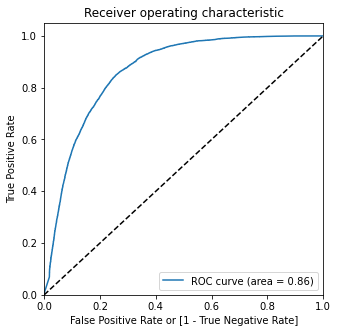

In [591]:
# Plotting the ROC curve using the function we had written earlier for ROC

draw_roc(y_train_pred_final_m21.Churned, y_train_pred_final_m21.Churn_Prob)

We have received a very ROC curve i.e. it doesn't merge at the 45-degree diagonal and is close to left hand axis and then the top border with 86% area under the curve for Model 21.

### Finding Optimal Cutoff Point

Optimal cutoff probability is that prob where we get balanced sensitivity and specificity

In [592]:
# Let's create columns with different probability cutoffs 

numbers = [float(x)/10 for x in range(10)]  # From 0.0 to 0.9
for i in numbers:
    y_train_pred_final_m21[i]= y_train_pred_final_m21.Churn_Prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final_m21.head()

,Churned,Churn_Prob,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
1436,0,2.421929e-01,0,1,1,1,0,0,0,0,0,0,0
3658,0,5.989799e-118,0,1,0,0,0,0,0,0,0,0,0
3465,0,7.540691e-01,1,1,1,1,1,1,1,1,1,0,0
54954,1,8.002983e-01,1,1,1,1,1,1,1,1,1,1,0
22347,0,7.994291e-01,1,1,1,1,1,1,1,1,1,0,0


In [593]:
# calculating accuracy, sensitivity and specificity for various probability cutoffs.

cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
from sklearn.metrics import confusion_matrix,accuracy_score

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final_m21.Churned, y_train_pred_final_m21[i] )
    
# TP = cm1[1,1] # true positive 
# TN = cm1[0,0] # true negatives
# FP = cm1[0,1] # false positives
# FN = cm1[1,0] # false negatives

    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1 # (TN+TP)/(TP+TN+FP+FN)
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])  # (TN)/(TN+FP)
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1]) # (TP)/(FN+TP)
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.514257  1.000000  0.030114
0.1   0.1  0.697153  0.983776  0.411474
0.2   0.2  0.736894  0.970564  0.503994
0.3   0.3  0.763227  0.951474  0.575599
0.4   0.4  0.783594  0.923253  0.644396
0.5   0.5  0.792687  0.872007  0.713629
0.6   0.6  0.791717  0.814446  0.769063
0.7   0.7  0.773750  0.716132  0.831179
0.8   0.8  0.663256  0.386603  0.938998
0.9   0.9  0.503637  0.005877  0.999758


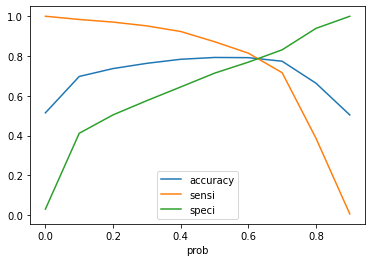

In [594]:
# Let's plot accuracy sensitivity and specificity for various probabilities.

cutoff_df.plot.line(x='prob', y=['accuracy','sensi','speci'])
plt.show()

`From the curve above, 0.62 is the optimum point to take it as a cutoff probability.`

In [595]:
# Using the optimal cut off received from the above curve

y_train_pred_final_m21['final_predicted'] = y_train_pred_final_m21.Churn_Prob.map( lambda x: 1 if x > 0.62 else 0)

y_train_pred_final_m21.head()

,Churned,Churn_Prob,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,final_predicted
1436,0,2.421929e-01,0,1,1,1,0,0,0,0,0,0,0,0
3658,0,5.989799e-118,0,1,0,0,0,0,0,0,0,0,0,0
3465,0,7.540691e-01,1,1,1,1,1,1,1,1,1,0,0,1
54954,1,8.002983e-01,1,1,1,1,1,1,1,1,1,1,0,1
22347,0,7.994291e-01,1,1,1,1,1,1,1,1,1,0,0,1


In [597]:
# confusion matrix
confusion_oc1 = metrics.confusion_matrix(y_train_pred_final_m21.Churned, y_train_pred_final_m21.final_predicted )
confusion_oc1

array([[16126,  4529],
       [ 4147, 16440]], dtype=int64)

In [611]:
TP = confusion_oc1[1,1] # true positive 
TN = confusion_oc1[0,0] # true negatives
FP = confusion_oc1[0,1] # false positives
FN = confusion_oc1[1,0] # false negatives

# Let's see the sensitivity of our optimal cut off derived from model 21
print("\n"+start+"Metrics derived based on the cut off of Model 21 : ",end = '')
print("\n"+start+"Sensitivity : ",end = '')
print(round(TP / float(TP+FN),3))

# Let us calculate specificity
print("\n"+start+"Specificity : ",end = '')
print(round(TN / float(TN+FP),3))

# Calculate false postive rate - predicting Converted when customer does not have Converted
print("\n"+start+"False Postive Rate : ",end = '')
print(round((FP/ float(TN+FP)),3))

# positive predictive value 
print("\n"+start+"Positive predictive value : ",end = '')
print (round(TP / float(TP+FP),3))

# Negative predictive value
print("\n"+start+"Negative predictive value : ",end = '')
print (round(TN / float(TN+ FN),3))

# Accuracy
print("\n"+start+"Accuracy value : ",end = '')
print(round(((TP+TN)/(TP+TN+FP+FN)),3))


Metrics derived based on the cut off of Model 21 : 
Sensitivity : 0.799

Specificity : 0.781

False Postive Rate : 0.219

Positive predictive value : 0.784

Negative predictive value : 0.795

Accuracy value : 0.79


### Making predictions on the test set

In [600]:
# Scaling the variables 

# scale
cols=['onnet_mou_6','onnet_mou_7','onnet_mou_8','offnet_mou_6','offnet_mou_7','offnet_mou_8','roam_ic_mou_6','roam_ic_mou_7','roam_ic_mou_8','roam_og_mou_6','roam_og_mou_7','roam_og_mou_8','loc_og_t2t_mou_6','loc_og_t2t_mou_7','loc_og_t2t_mou_8','loc_og_t2m_mou_6','loc_og_t2m_mou_7','loc_og_t2m_mou_8','loc_og_t2f_mou_6','loc_og_t2f_mou_7','loc_og_t2f_mou_8','loc_og_t2c_mou_6','loc_og_t2c_mou_7','loc_og_t2c_mou_8','loc_og_mou_6','loc_og_mou_7','loc_og_mou_8','std_og_t2m_mou_6','std_og_t2f_mou_6','std_og_t2f_mou_7','std_og_t2f_mou_8','std_og_mou_6','isd_og_mou_8','spl_og_mou_6','spl_og_mou_7','spl_og_mou_8','og_others_6','og_others_7','og_others_8','loc_ic_t2t_mou_6','loc_ic_t2t_mou_7','loc_ic_t2t_mou_8','loc_ic_t2m_mou_6','loc_ic_t2m_mou_7','loc_ic_t2m_mou_8','loc_ic_t2f_mou_6','loc_ic_t2f_mou_7','loc_ic_t2f_mou_8','std_ic_t2t_mou_6','std_ic_t2t_mou_7','std_ic_t2t_mou_8','std_ic_t2m_mou_6','std_ic_t2m_mou_7','std_ic_t2m_mou_8','std_ic_t2f_mou_6','std_ic_t2f_mou_7','std_ic_t2f_mou_8','std_ic_t2o_mou_6','std_ic_t2o_mou_7','std_ic_t2o_mou_8','std_ic_mou_6','std_ic_mou_7','std_ic_mou_8','spl_ic_mou_6','spl_ic_mou_7','spl_ic_mou_8','isd_ic_mou_6','isd_ic_mou_7','isd_ic_mou_8','ic_others_6','ic_others_7','ic_others_8','total_rech_num_6','total_rech_num_7','total_rech_num_8','total_rech_amt_6','total_rech_amt_7','total_rech_amt_8','max_rech_amt_6','max_rech_amt_7','max_rech_amt_8','last_day_rch_amt_6','last_day_rch_amt_7','last_day_rch_amt_8','total_rech_data_6','total_rech_data_7','total_rech_data_8','max_rech_data_6','max_rech_data_7','max_rech_data_8','count_rech_3g_6','count_rech_3g_7','count_rech_3g_8','av_rech_amt_data_6','av_rech_amt_data_7','av_rech_amt_data_8','vol_2g_mb_6','vol_2g_mb_7','vol_2g_mb_8','vol_3g_mb_6','vol_3g_mb_7','vol_3g_mb_8','arpu_2g_7','aon','aug_vbc_3g','jul_vbc_3g','jun_vbc_3g','sep_vbc_3g','Average_Recharge_Amt_6_7','Total_Recharge_Amt_8','Total_Incoming_Calls_6','Total_Outgoing_Calls_6','Total_Incoming_Calls_7','Total_Outgoing_Calls_7','Total_Incoming_Calls_8','Total_Outgoing_Calls_8']
X_test[cols] = scaler.transform(X_test[cols])

In [601]:
# Selecting the final columns which were used in Train set final model
X_test = X_test[col21]
X_test.head()

,std_og_mou_6,sep_vbc_3g,monthly_2g_7_2,monthly_2g_8_1,sachet_2g_6_18,sachet_2g_7_11,sachet_2g_8_7,monthly_3g_7_3,sachet_3g_6_10,Total_Outgoing_Calls_8
8819,-0.350111,-0.107628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.505625
32213,-0.369957,-0.107628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.507067
21977,-0.203763,-0.107628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.354566
30697,-0.430239,-0.107628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.676429
2422,0.665274,-0.107628,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.950527


In [602]:
# Adding the constant variable
X_test_sm = sm.add_constant(X_test[col21])

# Predicting the values using Model 10
y_test_pred = res21.predict(X_test_sm)
y_test_pred[:10]

8819     7.402197e-01
32213    7.446294e-01
21977    3.362815e-01
30697    8.088532e-01
2422     6.499934e-02
42500    8.058139e-01
19538    6.083096e-01
16607    3.418903e-31
9869     0.000000e+00
23153    1.539358e-01
dtype: float64

In [603]:
# Converting y_pred to a dataframe which is an array
y_pred_1 = pd.DataFrame(y_test_pred)

# Let's see the head
y_pred_1.head()

,0
8819,0.740220
32213,0.744629
21977,0.336281
30697,0.808853
2422,0.064999


In [604]:
y_test_df = pd.DataFrame(y_test)

# Removing index for both dataframes to append them side by side 
y_pred_1.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)

y_test_df.head()

,Churned
0,0
1,1
2,0
3,1
4,0


In [605]:
# Appending y_test_df and y_pred_1
y_pred_final = pd.concat([y_test_df, y_pred_1],axis=1)
y_pred_final.head()

,Churned,0
0,0,0.740220
1,1,0.744629
2,0,0.336281
3,1,0.808853
4,0,0.064999


In [606]:
# Renaming the column 
y_pred_final= y_pred_final.rename(columns={ 0 : 'Churn_Prob'})

# Rearranging the columns
y_pred_final = y_pred_final.reindex(['Churned','Churn_Prob'], axis=1)

# Let's see the head of y_pred_final
y_pred_final.head()

,Churned,Churn_Prob
0,0,0.740220
1,1,0.744629
2,0,0.336281
3,1,0.808853
4,0,0.064999


In [607]:
# Using the cut off received from plot accuracy sensitivity and specificity for various probabilities

y_pred_final['final_predicted'] = y_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.62 else 0)

y_pred_final.head()

,Churned,Churn_Prob,final_predicted
0,0,0.740220,1
1,1,0.744629,1
2,0,0.336281,0
3,1,0.808853,1
4,0,0.064999,0


In [608]:
# Let's check the overall accuracy.
round(metrics.accuracy_score(y_pred_final.Churned, y_pred_final.final_predicted),2)

0.79

In [609]:
# Confusion Matrix

confusion_test = metrics.confusion_matrix(y_pred_final.Churned, y_pred_final.final_predicted )
confusion_test

array([[6826, 1978],
       [1742, 7130]], dtype=int64)

In [767]:
TP = confusion_test[1,1] # true positive 
TN = confusion_test[0,0] # true negatives
FP = confusion_test[0,1] # false positives
FN = confusion_test[1,0] # false negatives

# Let's see the sensitivity of our logistic regression model
print("\n"+start+"Sensitivity : ",end = '')
print(round(TP / float(TP+FN),2))

# Accuracy
print("\n"+start+"Accuracy value : ",end = '')
print(round(((TP+TN)/(TP+TN+FP+FN)),3))


Sensitivity : 0.8

Accuracy value : 0.79


###  Summary 1 for Predictive Model

As we saw from above Prediction on Test Data, the target predicted using Model 21 is maintaining the sensitivity and accuracy for the cut off 0.62.
<br>
Model 21 has :<br>
`Train Data Sensitivity : 0.8`<br>
`Train Data Accuracy : 0.79`<br>

Since our Model 21 has proper features with p-value and Vif, we have chosen it for testing the data on Test set.

###### Final Model :

<i>`Sensitivity :`</i> 0.799<br>
<i>`Accuracy :`</i> 0.790<br>
<i>`Optimal Cut off :`</i> 0.62<br>

We have received Sensitivity,Accuracy as same value at cut off 0.62 while making sure that the sensitivity is around 80%. Hence, the company's expectation to decrease the churning rate is achieved while keeping the Sensitivity and accuracy intact.

#### Recomendation : 

1. The variables `Total_Incoming_Calls_8`,`total_rech_data_6`,`Total_Outgoing_Calls_8`,`max_rech_data_7`,`Total_Incoming_Calls_6`,<br>`total_rech_data_7`,`max_rech_data_6`,`total_rech_num_8`,`max_rech_data_8`,`loc_og_t2m_mou_8`,`td_ic_t2m_mou_6`,`td_ic_t2m_mou_8`,`count_rech_3g_6`,<br>`td_og_t2f_mou_6`,`td_og_t2f_mou_8`,`last_day_rch_amt_8`,`oc_og_t2f_mou_6`,`c_others_8`,`c_others_6`,`oam_og_mou_7`,`sep_vbc_3g` are significant in predicting the cutomers who are shoing any pattern of churning.

2. We can explain how well the selected variables describe the conversion rate by deriving the below Equation :

$ ConversionProb = 1/1+e^-(-42.8376 - (1.0288 \times std_og_mou_6) - (395.7874 \times sep_vbc_3g) - (1.4709 \times monthly_2g_7_2) - (1.7172 \times monthly_2g_8_1) + (2.3309 \times sachet_2g_6_18) - (0.5864 \times sachet_2g_7_11) - (1.0700 \times sachet_2g_8_7) - (1.8070 \times monthly_3g_7_3) + (2.9210 \times sachet_3g_6_10) - (1.8327 \times Total_Outgoing_Calls_8)))$

We can draw the below recomendations :
    
- Probability of Conversion is <b>decreased by -1.0288 times for every one unit increase in std_og_mou_6</b>
- Probability of Conversion is <b>decreased by -395.7874 times for every one unit increase in sep_vbc_3g</b>
- Probability of Conversion is <b>decreased by -1.4709 times for every one unit increase in monthly_2g_7_2</b>
- Probability of Conversion is <b>decreased by -1.7172 times for every one unit increase in monthly_2g_8_1</b> 
- Probability of Conversion is <b>increased by 2.3309 times for every one unit increase in sachet_2g_6_18</b>
- Probability of Conversion is <b>decreased by -0.5864 times for every one unit increase in sachet_2g_7_11</b>
- Probability of Conversion is <b>decreased by -1.0700 times for every one unit increase in sachet_2g_8_7</b> 
- Probability of Conversion is <b>decreased by -1.8070 times for every one unit increase in monthly_3g_7_3</b>
- Probability of Conversion is <b>increased by 2.9210 times for every one unit increase in sachet_3g_6_10</b>
- Probability of Conversion is <b>decreased by -1.8327 times for every one unit increase in Total_Outgoing_Calls_8</b>


### We will now build high performance Model with PCA

###### Using previous X_train which are already Standardised

#### `Model 1`

In [830]:
# Checking the shape of the X_train
X_train.shape

(41242, 342)

In [831]:
from sklearn.decomposition import PCA

In [832]:
pca = PCA(random_state=42)

In [833]:
# Running PCA on X_train
pca.fit(X_train)

PCA(random_state=42)

##### Components from PCA

In [834]:
# Checking the Components
pca.components_

array([[ 1.24828953e-01,  1.31295358e-01,  1.25567849e-01, ...,
         2.10012181e-01,  1.77657044e-01,  1.95537686e-01],
       [-4.51503596e-02, -4.07507262e-02, -1.93376152e-02, ...,
        -5.23524771e-02,  8.26602117e-02, -4.84552254e-03],
       [ 1.20830482e-01,  1.38415758e-01,  1.53218600e-01, ...,
         1.34913288e-01, -6.02496258e-02,  1.65879783e-01],
       ...,
       [-0.00000000e+00,  2.15915611e-17, -1.05741674e-18, ...,
        -1.19051193e-17,  5.75507036e-18, -6.86465218e-18],
       [-0.00000000e+00,  4.55544794e-18, -2.85318956e-18, ...,
        -1.84539697e-19,  7.49733499e-18, -2.33850048e-18],
       [-0.00000000e+00,  8.94382021e-18, -2.21767641e-18, ...,
         2.56447940e-18,  4.76424597e-17,  3.63106220e-18]])

Looking at the explained variance ratio for each component

In [835]:
# Variance Ratio for each component
pca.explained_variance_ratio_

array([1.19464435e-01, 8.46015228e-02, 4.78864034e-02, 4.62842476e-02,
       3.86672054e-02, 3.17596053e-02, 2.96481415e-02, 2.65799686e-02,
       2.49317687e-02, 2.34795088e-02, 2.27845493e-02, 2.12747127e-02,
       1.98790592e-02, 1.77643228e-02, 1.72711405e-02, 1.61671169e-02,
       1.55621546e-02, 1.52734380e-02, 1.43845348e-02, 1.35480997e-02,
       1.26656531e-02, 1.23092878e-02, 1.15932993e-02, 1.11287093e-02,
       1.05870786e-02, 1.02207813e-02, 9.51901147e-03, 8.98257545e-03,
       8.74842638e-03, 8.48518717e-03, 8.36798139e-03, 8.13500055e-03,
       7.78105752e-03, 7.60720083e-03, 7.47603184e-03, 7.34739594e-03,
       6.92488828e-03, 6.59551038e-03, 6.56167425e-03, 6.41294890e-03,
       6.32787507e-03, 5.84049002e-03, 5.54222774e-03, 5.42881092e-03,
       5.28877702e-03, 5.07077601e-03, 4.91593321e-03, 4.73928415e-03,
       4.61937741e-03, 4.42342356e-03, 4.22184321e-03, 4.07366719e-03,
       3.86438640e-03, 3.75989164e-03, 3.62082489e-03, 3.52687359e-03,
      

We will now make a scree plot for the explained variance

In [836]:
# Taking the cummulative sum
var_cumu = np.cumsum(pca.explained_variance_ratio_)

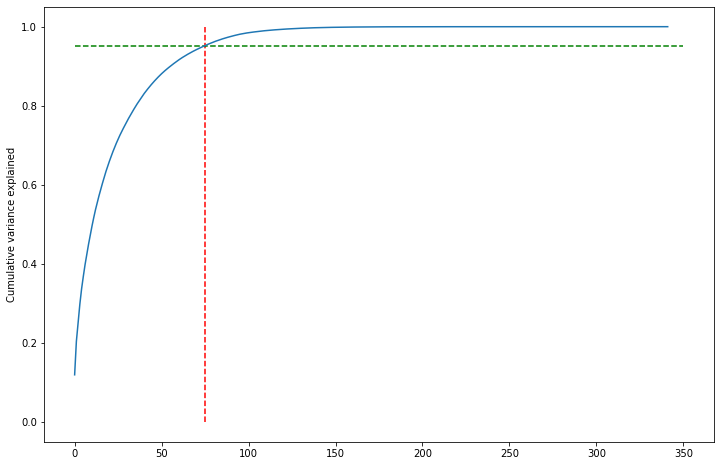

In [837]:
# Plotting the scree
fig = plt.figure(figsize=[12,8])
plt.vlines(x=75, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=350, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

From the above scree plot, we can see that 75 components are coming as optimal number of components to build a model

Perform PCA with 75 components

In [838]:
from sklearn.decomposition import IncrementalPCA

In [839]:
# Using INcremental PCA to build PCA only specified number of times
pca_final = IncrementalPCA(n_components=75)

In [840]:
df_train_pca = pca_final.fit_transform(X_train)

In [841]:
# Checking the shape
df_train_pca.shape

(41242, 75)

In [842]:
# Getting the Correlation Matrix
corrmat = np.corrcoef(df_train_pca.transpose())

In [843]:
print(corrmat)

[[ 1.00000000e+00  9.16361337e-07  3.62982339e-07 ...  3.45318775e-05
   6.66886753e-05 -9.73276237e-05]
 [ 9.16361337e-07  1.00000000e+00 -5.18630200e-07 ...  2.19858748e-05
   3.15262561e-05 -1.90517135e-05]
 [ 3.62982339e-07 -5.18630200e-07  1.00000000e+00 ...  8.65030499e-06
   5.80374422e-05  1.89461586e-05]
 ...
 [ 3.45318775e-05  2.19858748e-05  8.65030499e-06 ...  1.00000000e+00
   2.77092207e-03 -1.80091465e-03]
 [ 6.66886753e-05  3.15262561e-05  5.80374422e-05 ...  2.77092207e-03
   1.00000000e+00 -1.35711412e-03]
 [-9.73276237e-05 -1.90517135e-05  1.89461586e-05 ... -1.80091465e-03
  -1.35711412e-03  1.00000000e+00]]


Applying the transformation on the test set

In [844]:
# Applying the transform on X_test
df_test_pca = pca_final.transform(X_test)
df_test_pca.shape

(17676, 75)

### Applying PCA on Models
### `Model 1 - Logistic Regression`

In [793]:
from sklearn.linear_model import LogisticRegression
learner_pca = LogisticRegression()

In [794]:
# Fitting the model
model_pca = learner_pca.fit(df_train_pca, y_train)

###### Making predictions on the test set

In [795]:
# Using transformed test data set
pred_probs_test = model_pca.predict_proba(df_test_pca)

In [796]:
# Checking the roc-auc of the test set 

print("The roc-auc of the test set is : ")
"{:2.2}".format(metrics.roc_auc_score(y_test, pred_probs_test[:,1]))

The roc-auc of the test set is : 


'0.84'

In the above model, we have used n_components parameter to decide how many components we need in our model. Now we will builld another model to perform dimensionality reduction.

###### Applying PCA to reduce Dimensionality

We will build the second PCA model with variance we want instead of scree component

In [747]:
# We are passing 0.5 as the variance
# PCA will select only those no. of componets which satisfy the variance
pca_2 = PCA(0.5)

In [748]:
# Fitting on Train data
df_train_pca2 = pca_2.fit_transform(X_train)

In [749]:
df_train_pca2.shape

(41242, 12)

Build Model using Logistic Regression using pca components

In [750]:
# Building new logistic model
learner_pca2 = LogisticRegression()

In [751]:
# # Fitting the model
model_pca2 = learner_pca2.fit(df_train_pca2, y_train)

###### Predicting on test data

In [752]:
# Applying the PCA on test data
df_test_pca2 = pca_2.transform(X_test)

In [753]:
df_test_pca2.shape

(17676, 12)

In [754]:
# Predicting on test data
pred_probs_test2 = model_pca2.predict_proba(df_test_pca2)[:,1]

###### Model Evaluation

In [755]:
# Calculating ROC-AUC after dimentionality reduction
"{:2.2}".format(metrics.roc_auc_score(y_test, pred_probs_test2))

'0.87'

##### Using PCA we are gettiing 87% accuracy using Logistic regression algorithm.

### `Model 2 -  XGBoost`

We will now build another model using XGBoost to get the high performance with PCA.
We will build the XGBoost model with default parameters at first.

In [845]:
# Importing relevant library to use xgb

import xgboost as xgb
from sklearn import metrics

xgclf = xgb.XGBClassifier()

xgclf.fit(df_train_pca, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [846]:
# AUC on train data

print('AUC on train data by XGBoost =', metrics.roc_auc_score(y_true=y_train,
                                                              y_score=xgclf.predict_proba(df_train_pca)[:, 1]))

AUC on train data by XGBoost = 0.9999999929449029


In [847]:
# AUC on test data

print('AUC on test data by XGBoost =', metrics.roc_auc_score(y_true=y_test,
                                                             y_score=xgclf.predict_proba(df_test_pca)[:, 1]))

AUC on test data by XGBoost = 0.6417441143340452


We will build the XGBoost model with some values passed to hyper-parameters.

In [872]:
xgb_model = xgb.XGBClassifier()

# Default-Run of default-hyperparameters
parameters = {'learning_rate': [0.3],
              'max_depth': [6],
              'n_estimators': [100]}

scorer = metrics.make_scorer(metrics.roc_auc_score,
                             greater_is_better=True,
                             needs_proba=True,
                             needs_threshold=False)

clf_xgb = model_selection.GridSearchCV(estimator=xgb_model,
                                       param_grid=parameters,
                                       n_jobs=-1,
                                       cv=3,
                                       scoring=scorer,
                                       refit=True)

clf_xgb.fit(df_train_pca, y_train)

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=None,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None,

The best parameters, score and estimators for the above model 

In [873]:
# Printing best params, scores and estimators
print(clf_xgb.best_params_)
print(clf_xgb.best_score_)
print(clf_xgb.best_estimator_)

{'learning_rate': 0.3, 'max_depth': 6, 'n_estimators': 100}
0.9981408501880754
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.3, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


In [874]:
# AUC on train data

print('AUC on train data by XGBoost =', metrics.roc_auc_score(y_true=y_train,
                                                              y_score=clf_xgb.predict_proba(df_train_pca)[:, 1]))

# AUC on test data

print('AUC on test data by XGBoost =', metrics.roc_auc_score(y_true=y_test,
                                                             y_score=clf_xgb.predict_proba(df_test_pca)[:, 1]))

AUC on train data by XGBoost = 0.9999999929449029
AUC on test data by XGBoost = 0.6417441143340452


#### Hyper Parameter Tuning

We will now tune the hyper parameters and try to achieve best model with best values of params

In [876]:
# Sets of different values for parameters
parameters = {'learning_rate': [0.3, 0.4, 0.5],
              'max_depth': [2, 3, 4, 5, 6],
              'n_estimators': [20,40,60,80,100]}

scorer = metrics.make_scorer(metrics.roc_auc_score,
                             greater_is_better=True,
                             needs_proba=True,
                             needs_threshold=False)


In [877]:
clf_xgb = model_selection.GridSearchCV(estimator=xgb_model,
                                       param_grid=parameters,
                                       n_jobs=-1,
                                       cv=3,
                                       scoring=scorer,
                                       refit=True)

In [878]:
# Fitting the model on PCA train data
clf_xgb.fit(df_train_pca, y_train)

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=None,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None,

The params, score and estimators for the model built.

In [879]:
# Printing best params, scores and estimators
print(clf_xgb.best_params_)
print(clf_xgb.best_score_)
print(clf_xgb.best_estimator_)

{'learning_rate': 0.4, 'max_depth': 6, 'n_estimators': 100}
0.9982379407600006
XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.4, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


In [880]:
# AUC on train data

print('AUC on train data by XGBoost =', metrics.roc_auc_score(y_true=y_train,
                                                              y_score=clf_xgb.predict_proba(df_train_pca)[:, 1]))

# AUC on test data

print('AUC on test data by XGBoost =', metrics.roc_auc_score(y_true=y_test,
                                                             y_score=clf_xgb.predict_proba(df_test_pca)[:, 1]))

AUC on train data by XGBoost = 1.0
AUC on test data by XGBoost = 0.6995988162094532


### `Model 3 - Random Forest`

In [853]:
# Library to use Random Forest 
from sklearn.ensemble import RandomForestClassifier

Building Random forest model by giving some values to the hyper-parameters

In [854]:
# Creating the Random forest object with some hyper parameters
rf = RandomForestClassifier(n_estimators=10, max_depth=4, max_features=5, random_state=100, oob_score=True)

In [855]:
# Fitting the model to train set
rf.fit(df_train_pca, y_train)

RandomForestClassifier(max_depth=4, max_features=5, n_estimators=10,
                       oob_score=True, random_state=100)

In [856]:
# To validate the performance of the Random forest, we will check the oob score
rf.oob_score_

0.7784297560739052

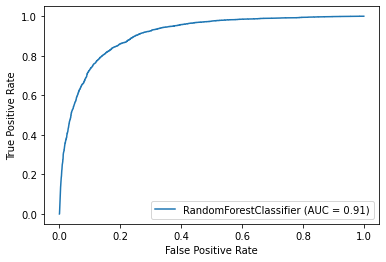

In [857]:
# Plotting ROC-AUC Curve
from sklearn.metrics import confusion_matrix, accuracy_score,plot_roc_curve
plot_roc_curve(rf, df_train_pca, y_train)
plt.show()

From above plot, we can see that the area under the curve is coming as .91

In [859]:

# Fundtion to get the values of the random forest
def evaluate_model(dt_classifier):
    print("Train Accuracy :", accuracy_score(y_train, dt_classifier.predict(df_train_pca)))
    print("Train Confusion Matrix:")
    print(confusion_matrix(y_train, dt_classifier.predict(df_train_pca)))
    print("-"*50)
    print("Test Accuracy :", accuracy_score(y_test, dt_classifier.predict(df_test_pca)))
    print("Test Confusion Matrix:")
    print(confusion_matrix(y_test, dt_classifier.predict(df_test_pca)))

In [860]:
evaluate_model(rf)

Train Accuracy : 0.8310460210465059
Train Confusion Matrix:
[[17278  3377]
 [ 3591 16996]]
--------------------------------------------------
Test Accuracy : 0.5082597872821906
Test Confusion Matrix:
[[8790   14]
 [8678  194]]


So, from the above random forest, we got Accuracy on Train as 83% and on test we got Accuracy as 51%

#### Hyper Parameter Tuning

We will further tune the parameters in Random Forest to get the best estimators and score

In [863]:
# creating the random forest object
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [864]:
# Sets of different values for parameters
params = {
    'max_depth': [2,3,5,10,20],
    'min_samples_leaf': [50,100,300],
    'n_estimators': [10, 25, 50, 100]
}

In [866]:
grid_search = model_selection.GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 4,
                           n_jobs=-1, verbose=1, scoring="accuracy")

In [867]:
# Fitting the train model
grid_search.fit(df_train_pca, y_train)

Fitting 4 folds for each of 60 candidates, totalling 240 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   39.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:  4.5min
[Parallel(n_jobs=-1)]: Done 240 out of 240 | elapsed:  7.0min finished


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [50, 100, 300],
                         'n_estimators': [10, 25, 50, 100]},
             scoring='accuracy', verbose=1)

In [868]:
# The best score obtained
grid_search.best_score_

0.9236214895225979

In [869]:
# The best estimators obtained
rf_best = grid_search.best_estimator_
rf_best

RandomForestClassifier(max_depth=20, min_samples_leaf=50, n_jobs=-1,
                       random_state=42)

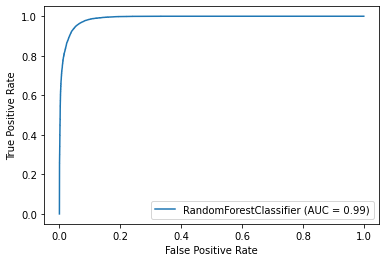

In [870]:
plot_roc_curve(rf_best, df_train_pca, y_train)
plt.show()

From the above ROC plot, we can see that the AUC for Random forest after hyper parameter tuning is 0.99

In [871]:
evaluate_model(rf_best)

Train Accuracy : 0.9485960913631735
Train Confusion Matrix:
[[19414  1241]
 [  879 19708]]
--------------------------------------------------
Test Accuracy : 0.5030549898167006
Test Confusion Matrix:
[[8799    5]
 [8779   93]]


###  Summary 2 for High Performance Model

In this section, our main focus was to build high performance Model.
We applied PCA on the data set and then used PCA components to build three models i.e.
1. Logistic Regression
2. XGBoost
3. Random Forest

##### `PCA Output`

- After performing PCA on the balanced data set, we got 75 components with 0.95 variance.

##### `Logistic Regression`

- After building Logistic Regression on PCA components, we got below scores : 
        - ROC-AUC Score : 0.87
        
##### `XGBoost`

- We first built a default model with some random values provided to Hyper parameters. The Score for this model:
        - AUC on train data by XGBoost = 0.9999999929449029
        - AUC on test data by XGBoost = 0.6417441143340452
- We applied hyper parameter tuning and performed K-fold cross validation. We got below scores for best XGBoost model : 
        - AUC on train data by XGBoost = 1.0
        - AUC on test data by XGBoost = 0.6995988162094532

##### `Random Forest`

- We first built a default model with some random values provided to Hyper parameters. The Score for this model:
        - Train Accuracy : 0.8310460210465059
        - Test Accuracy : 0.5082597872821906
- We applied hyper parameter tuning and performed K-fold cross validation. We got below scores for best Random Forest model : 
        - Train Accuracy : 0.9485960913631735
        - Test Accuracy : 0.5030549898167006